In [1]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import pandas as pd
import seaborn as sns
import h5py
import tqdm
import zipfile
from tqdm.notebook import tqdm_notebook
from progress.bar import IncrementalBar
import random
import pandas as pd
import os
# tf.config.run_functions_eagerly(True)
%matplotlib inline

In [2]:
# %env CUDA_DEVICE_ORDER=PCI_BUS_ID
# %env CUDA_VISIBLE_DEVICES=1

In [3]:
import glob

In [4]:
path='seccessful_models/kern2'
def find_generator(path:str):
    csv_name=glob.glob(path+'/*.csv')
    df=pd.read_csv(csv_name[0])
    epoch=list(df[df.metric==df.metric.min()]['name'])[0]
    epoch=epoch.replace('epoch_','ep')
    return os.path.join(path+'/save_model/generator',epoch)
find_generator(path)

'seccessful_models/kern2/save_model/generator/ep26'

In [37]:
mean_metric_dict={'seccessful_models/with_CONV2_real/save_model/generator/ep8': 0.00977730382601294, 'seccessful_models/kern2/save_model/generator/ep26': 0.010261240639920288, 'seccessful_models/noise_398/save_model/generator/ep23': 0.010312523058814804, 'seccessful_models/noise_233/save_model/generator/ep20': 0.010229519551444355}
df=pd.DataFrame([mean_metric_dict])
main_path=''
df
# df.to_csv(main_path+'/mean_metric.csv')

,seccessful_models/with_CONV2_real/save_model/generator/ep8,seccessful_models/kern2/save_model/generator/ep26,seccessful_models/noise_398/save_model/generator/ep23,seccessful_models/noise_233/save_model/generator/ep20
0,0.009777,0.010261,0.010313,0.01023


In [4]:
gpus = tf.config.list_physical_devices('GPU')
print(gpus)
for gpu in gpus:
    tf.config.experimental.set_memory_growth(gpu, True)

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [5]:
with h5py.File("mc_wfmax_norm.h5",'r') as f:
    print(list(f.keys()))
    norm_param=f['norm_param'][:]
    test=f['test'][:]
    train=f['train'][:472320]
    print(f['train'].shape)
# mean=train.mean()
# train=train-mean
# train=train/(np.absolute(train)).max()
train=(train+1)/2
test=(test+1)/2
print(train.min(),train.max(),train.mean())
print(len(train))
print(norm_param)

['norm_param', 'test', 'train']
(472351, 128, 2)
0.0 1.0 0.025971571
472320
[[ 0.04490717  0.04396976]
 [-0.99174523 -0.9909725 ]]


In [6]:
import metric

In [10]:
def find_noise(generator,discriminator,image,noise_dim,alpha=1.2,k_rd=0.0001):
    loss_befor=1000000000
    k=0
    optimize=tf.keras.optimizers.Adam()
    noise = tf.random.normal(shape=(image.shape[0],noise_dim))
    noise_befor=tf.identity(noise)
    for i in range(3000):
        with tf.GradientTape() as tape:
            tape.watch(noise)
            fake=generator(noise)
            loss=Residual_loss(image, fake)
            loss_disc=Discriminator_loss(image, fake,discriminator)*k_rd
            Loss=tf.reshape(loss,(-1,1))+loss_disc
        g_grad=tape.gradient(Loss,noise.trainable_variables)
        optimize.apply_gradients(zip(g_grad, noise.trainable_variables))
        if tf.math.reduce_mean((loss_befor-Loss))<0.005*tf.math.reduce_mean(Loss):
            k+=1
            if k>7:
                break
        else:
            loss_befor=Loss
            k=0
            
    return (noise,noise_befor)

In [8]:
generator=tf.keras.models.load_model('398noise_difdata/huge0.2/save_model/generator/ep8')
discriminator=tf.keras.models.load_model('398noise_difdata/huge0.2/save_model/discriminator/ep8')
q=test[1000]
noise=metric.find_noise(generator,discriminator,image=q,noise_dim=398,alpha=1.2,k_rd=0.0001)[0]
fake_data=generator(noise)
# fig,axs=plt.subplots(5,2,figsize=(20,18))
# for i in range(5):
#     axs[i,0].plot(fake_data[i,:,1],'r')#change
#     axs[i,0].plot(fake_data[i,:,0],'b')
#     axs[i,1].plot(q[i,:,1],'r')
#     axs[i,1].plot(q[i,:,0],'b')
# #     plt.suptitle("epoch:"+str(n))

ValueError: Input 0 is incompatible with layer Discriminator_model_num_: expected shape=(None, 128, 2), found shape=(128, 2)

In [67]:
%%time
q=test[:1000]
noise=metric.find_noise(generator,discriminator,image=q,noise_dim=398,alpha=1.2,k_rd=0.0001)[0]
fake_data=generator(noise)

CPU times: user 1h 41min 42s, sys: 12min 7s, total: 1h 53min 49s
Wall time: 20min 14s


In [14]:
import metric_ as metric

(5, 128, 2)
tf.Tensor(
[[0.00061161]
 [0.00055099]
 [0.00170775]
 [0.00092532]
 [0.00072744]], shape=(5, 1), dtype=float32)


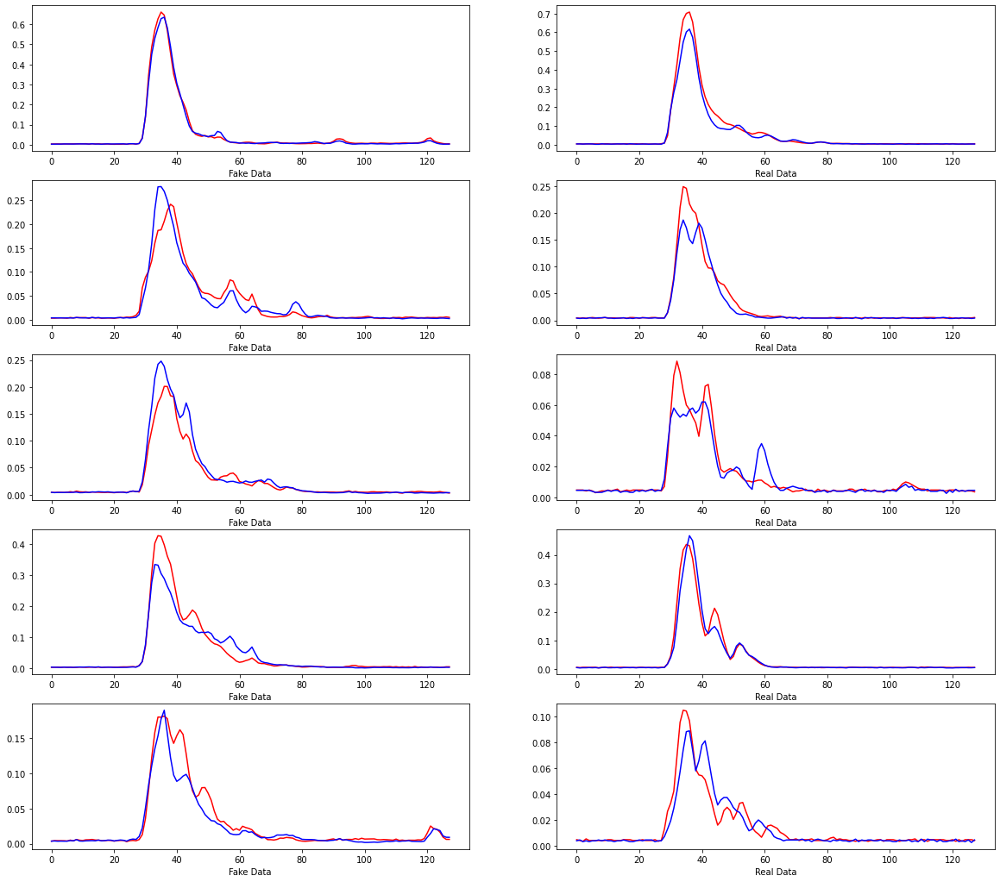

In [10]:
# generator=tf.keras.models.load_model('seccessful_models/noise_398/save_model/generator/ep23')
# discriminator=tf.keras.models.load_model('seccessful_models/noise_398/save_model/discriminator/ep23')
generator=tf.keras.models.load_model('398noise_difdata/huge0.2/save_model/generator/ep'+str(8))
discriminator=tf.keras.models.load_model('398noise_difdata/huge0.2/save_model/discriminator/ep8')
ll=test[:5]
noise,_,loss=metric.find_noise(generator,discriminator,image=ll,noise_dim=398,alpha=1.2,k_rd=0)
fake_data=generator(noise)
print(fake_data.shape)
fig,axs=plt.subplots(5,2,figsize=(20,18))
for i in range(5):
    axs[i,0].plot(fake_data[i,:,1],'r')#change
    axs[i,0].plot(fake_data[i,:,0],'b')
#     axes[i,0].set_xlabel("Временой интервал (20нс)")
    axs[i,0].set_xlabel('Fake Data')
    axs[i,1].plot(ll[i,:,1],'r')
    axs[i,1].plot(ll[i,:,0],'b')
    axs[i,1].set_xlabel("Real Data")
print(loss)
#     axes[i,1].set_ylabel('показания детектора')
#     plt.suptitle("epoch:"+str(n))
#     plt.savefig("{}/save_images/epoch{}.png".format(dir_name,n))

### anomaly search k_rd=0

(5, 128, 2)
tf.Tensor(
[[0.00700573]
 [0.00381911]
 [0.00868286]
 [0.00686939]
 [0.00358042]], shape=(5, 1), dtype=float32)


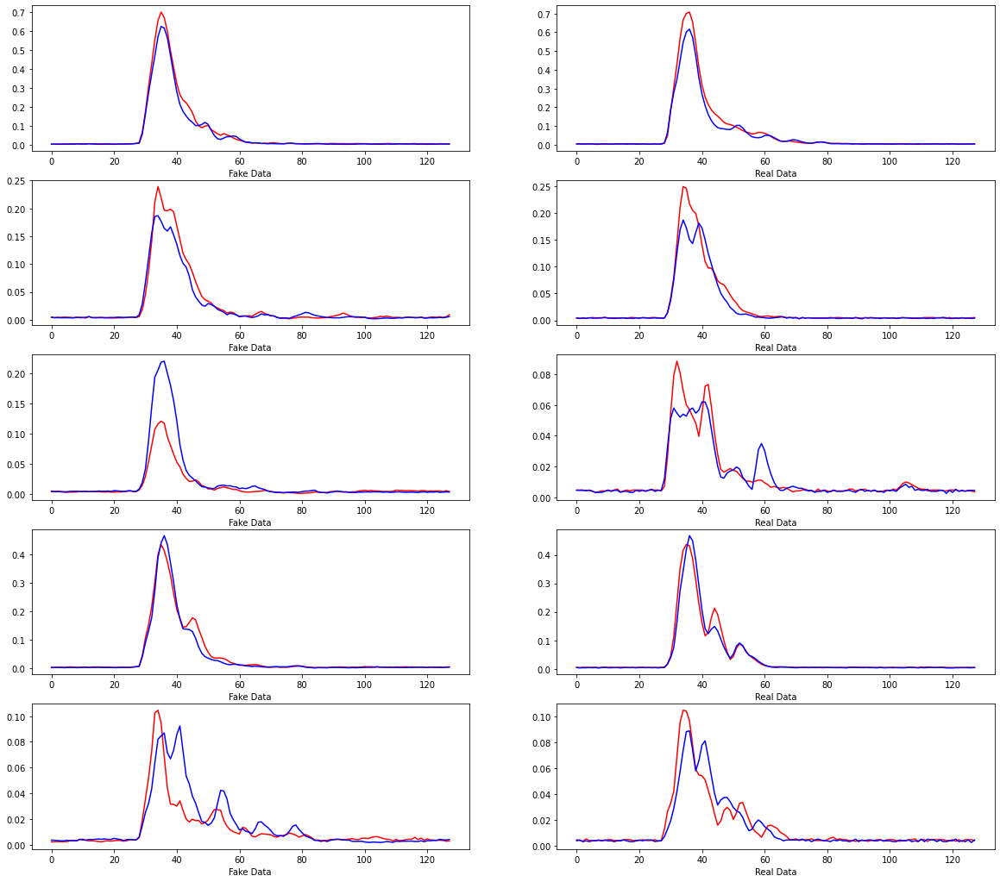

In [7]:
generator=tf.keras.models.load_model('398noise_difdata/huge0.2/save_model/generator/ep'+str(8))
discriminator=tf.keras.models.load_model('398noise_difdata/huge0.2/save_model/discriminator/ep8')
ll=test[:5]
noise,n_b,loss=metric.find_noise(generator,discriminator,image=ll,noise_dim=398,alpha=1.2,k_rd=0)
fake_data=generator(noise)
print(fake_data.shape)
fig,axs=plt.subplots(5,2,figsize=(20,18))
for i in range(5):
    axs[i,0].plot(fake_data[i,:,1],'r')#change
    axs[i,0].plot(fake_data[i,:,0],'b')

#     axes[i,0].set_xlabel("Временой интервал (20нс)")
    axs[i,0].set_xlabel('Fake Data')
    axs[i,1].plot(ll[i,:,1],'r')
    axs[i,1].plot(ll[i,:,0],'b')
    axs[i,1].set_xlabel("Real Data")
print(loss)
#     axes[i,1].set_ylabel('показания детектора')
#     plt.suptitle("epoch:"+str(n))
#     plt.savefig("{}/save_images/epoch{}.png".format(dir_name,n))

In [11]:
generator=tf.keras.models.load_model('398noise_difdata/huge0.2/save_model/generator/ep'+str(8))
discriminator=tf.keras.models.load_model('398noise_difdata/huge0.2/save_model/discriminator/ep8')
ll=test[:5]
noise,_,loss=metric.find_noise(generator,discriminator,image=ll,noise_dim=398,alpha=0.5,k_rd=0)[0]
fake_data=generator(noise)
print(fake_data.shape)
fig,axs=plt.subplots(5,2,figsize=(20,18))
for i in range(5):
    axs[i,0].plot(fake_data[i,:,1],'r')#change
    axs[i,0].plot(fake_data[i,:,0],'b')
#     axes[i,0].set_xlabel("Временой интервал (20нс)")
    axs[i,0].set_xlabel('Fake Data')
    axs[i,1].plot(ll[i,:,1],'r')
    axs[i,1].plot(ll[i,:,0],'b')
    axs[i,1].set_xlabel("Real Data")
print(loss)
#     axes[i,1].set_ylabel('показания детектора')
#     plt.suptitle("epoch:"+str(n))
#     plt.savefig("{}/save_images/epoch{}.png".format(dir_name,n))

ValueError: too many values to unpack (expected 3)

### ADAM


In [12]:
def return_data():
    with h5py.File("mc_wfmax_norm.h5",'r') as f:
        norm_param=f['norm_param'][:]
        test=f['test'][:]
        train=f['train'][:472320]
        
    train=(train+1)/2
    test=(test+1)/2
    
    train_huge=train[train.max(axis=1).max(axis=1)>0.2]
    train.shape
    train=train[:2425*64]

    train_small=train[train.max(axis=1).max(axis=1)<0.2][:(25000//64)*64+2]
    train=np.append(train_small,train_huge,axis=0)
    np.random.shuffle(train)
    
    test_huge=test[test.max(axis=1).max(axis=1)>0.2]
    test_small=test[test.max(axis=1).max(axis=1)<0.2][:(8000//64)*64+2]
    test=np.append(test_small,test_huge,axis=0)
    np.random.seed(42)
    np.random.shuffle(test)
    return (train,test[:4000])

def Residual_loss(data_true, data_fake):
    return tf.reduce_mean( tf.math.abs(data_true - data_fake),axis=(1,2))
def Discriminator_loss(data_true, data_fake,discriminator):
    real_pred=discriminator(data_true)
    fake_pred=discriminator(data_fake)
    return tf.math.abs( real_pred - fake_pred)
def adam(x, n_iter, alpha, beta1, beta2, eps=1e-8):
	m = [0.0 for _ in range(x.shape[0])]
	v = [0.0 for _ in range(x.shape[0])]
	# run the gradient descent updates
	for t in range(n_iter):
		# calculate gradient g(t)
		g = derivative(x[0], x[1])
		# build a solution one variable at a time
		for i in range(x.shape[0]):
			# m(t) = beta1 * m(t-1) + (1 - beta1) * g(t)
			m[i] = beta1 * m[i] + (1.0 - beta1) * g[i]
			# v(t) = beta2 * v(t-1) + (1 - beta2) * g(t)^2
			v[i] = beta2 * v[i] + (1.0 - beta2) * g[i]**2
			# mhat(t) = m(t) / (1 - beta1(t))
			mhat = m[i] / (1.0 - beta1**(t+1))
			# vhat(t) = v(t) / (1 - beta2(t))
			vhat = v[i] / (1.0 - beta2**(t+1))
			# x(t) = x(t-1) - alpha * mhat(t) / (sqrt(vhat(t)) + eps)
			x[i] = x[i] - alpha * mhat / (sqrt(vhat) + eps)
		# evaluate candidate point
		score = objective(x[0], x[1])
		# report progress
		print('>%d f(%s) = %.5f' % (t, x, score))
	return [x, score]

def find_noise(generator,discriminator,image,noise_dim,alpha=1.2,k_rd=0.0001,beta1=0.9,
    beta2=0.999,
    eps=1e-07):
    loss_befor=1000000000
    k=0

    optimize=tf.keras.optimizers.Adam()
    noise = tf.random.normal(shape=(image.shape[0],noise_dim))
    noise_befor=tf.identity(noise)
    m = np.zeros(noise.shape)
    v = np.zeros(noise.shape)
    for i in range(3000):
        t=1
        with tf.GradientTape() as tape:
            tape.watch(noise)
            fake=generator(noise)
            loss=Residual_loss(image, fake)
            loss_disc=Discriminator_loss(image, fake,discriminator)*k_rd
            Loss=tf.reshape(loss,(-1,1))+loss_disc
#         for j in range(x.shape[0]):
#         print(Loss.shape)
        g_grad=tape.gradient(Loss,noise)
#         print(g_grad.shape)
#         optimize.update_step(g_grad, noise)
        m = beta1 * m + (1.0 - beta1) * g_grad
        v = beta2 * v + (1.0 - beta2) * g_grad**2
        mhat = m / (1.0 - beta1**(t+1))
        vhat = v / (1.0 - beta2**(t+1))
        noise = noise - alpha * mhat / (np.sqrt(vhat) + eps)
        if tf.math.reduce_mean((loss_befor-Loss))<0.005*tf.math.reduce_mean(Loss):
            k+=1
            if k>7:
                break
        else:
            loss_befor=Loss
            k=0
            
    return (noise,noise_befor)

(5, 128, 2)


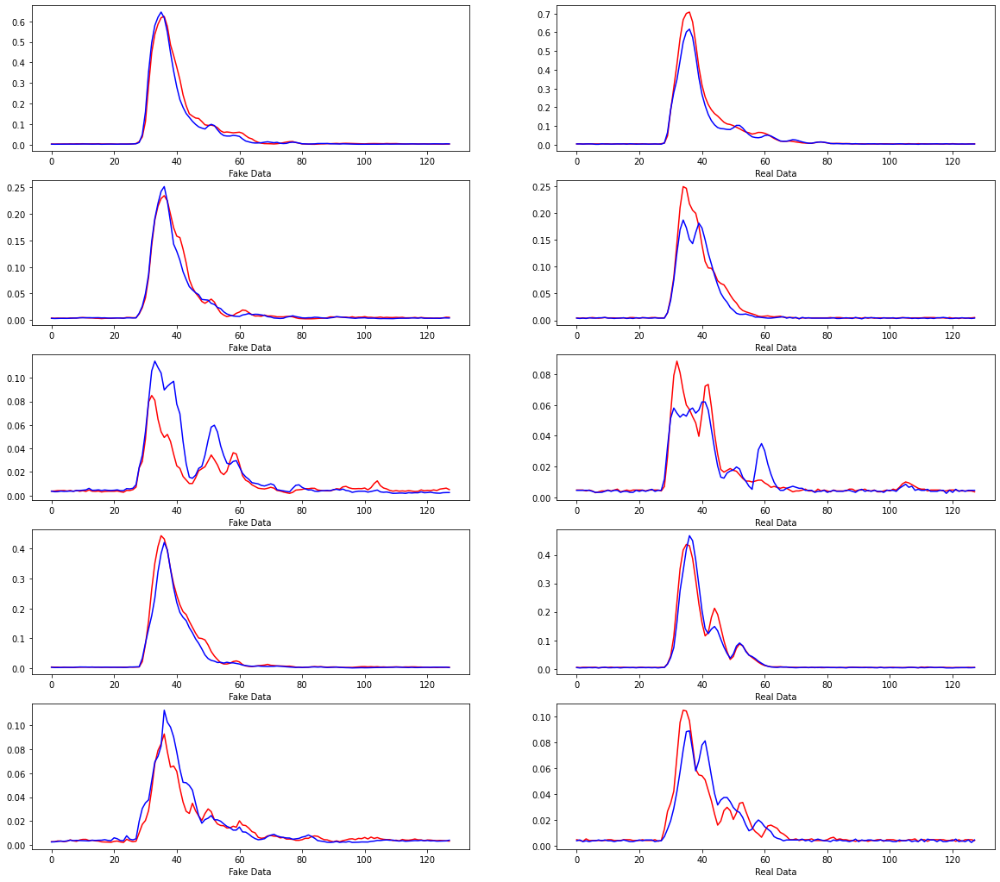

In [52]:
generator=tf.keras.models.load_model('398noise_difdata/huge0.2/save_model/generator/ep'+str(8))
discriminator=tf.keras.models.load_model('398noise_difdata/huge0.2/save_model/discriminator/ep8')
ll=test[:5]
noise=find_noise(generator,discriminator,image=ll,noise_dim=398,alpha=0.001,k_rd=0.0001,beta1=0.9)[0]
fake_data=generator(noise)
print(fake_data.shape)
fig,axs=plt.subplots(5,2,figsize=(20,18))
for i in range(5):
    axs[i,0].plot(fake_data[i,:,1],'r')#change
    axs[i,0].plot(fake_data[i,:,0],'b')
#     axes[i,0].set_xlabel("Временой интервал (20нс)")
    axs[i,0].set_xlabel('Fake Data')
    axs[i,1].plot(ll[i,:,1],'r')
    axs[i,1].plot(ll[i,:,0],'b')
    axs[i,1].set_xlabel("Real Data")
#     axes[i,1].set_ylabel('показания детектора')
#     plt.suptitle("epoch:"+str(n))
#     plt.savefig("{}/save_images/epoch{}.png".format(dir_name,n))

In [ ]:
generator=tf.keras.models.load_model('398noise_difdata/huge0.2/save_model/generator/ep'+str(8))
discriminator=tf.keras.models.load_model('398noise_difdata/huge0.2/save_model/discriminator/ep8')
ll=test[:5]
noise=find_noise(generator,discriminator,image=ll,noise_dim=398,alpha=0.001,k_rd=0,beta1=0.9)[0]
fake_data=generator(noise)
print(fake_data.shape)
fig,axs=plt.subplots(5,2,figsize=(20,18))
for i in range(5):
    axs[i,0].plot(fake_data[i,:,1],'r')#change
    axs[i,0].plot(fake_data[i,:,0],'b')
#     axes[i,0].set_xlabel("Временой интервал (20нс)")
    axs[i,0].set_xlabel('Fake Data')
    axs[i,1].plot(ll[i,:,1],'r')
    axs[i,1].plot(ll[i,:,0],'b')
    axs[i,1].set_xlabel("Real Data")
#     axes[i,1].set_ylabel('показания детектора')
#     plt.suptitle("epoch:"+str(n))
#     plt.savefig("{}/save_images/epoch{}.png".format(dir_name,n))

In [50]:
#HYPER PARAMETERS
noise_dim=200
shape_data=train[0].shape
shape=(128,2)
# generator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.00001, beta_1=0, beta_2=0.9)
generator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0001, beta_1=0, beta_2=0.9)
discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0001, beta_1=0, beta_2=0.9)
loss_function = tf.keras.losses.BinaryCrossentropy(from_logits=True)
scal_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0001, beta_1=0, beta_2=0.9)

In [13]:
len(train)

180224

In [46]:
pd=pd.read_csv('seccessful_models/mean_metric.csv')
pd

,Unnamed: 0,seccessful_models/with_CONV2_real/save_model/generator/ep8,seccessful_models/kern2/save_model/generator/ep26,seccessful_models/noise_398/save_model/generator/ep23,seccessful_models/noise_233/save_model/generator/ep20
0,0,0.010204,0.009949,0.009891,0.010131


In [48]:
disc='seccessful_models/noise_398/save_model/generator/ep0'
disc=tf.keras.models.load_model(disc)
disc.summary()

Model: "Generator_model_"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 398)]        0                                            
__________________________________________________________________________________________________
tf.__operators__.getitem (Slici (None, 200)          0           input_1[0][0]                    
__________________________________________________________________________________________________
dense (Dense)                   (None, 200)          40000       tf.__operators__.getitem[0][0]   
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 200)          800         dense[0][0]                      
___________________________________________________________________________________

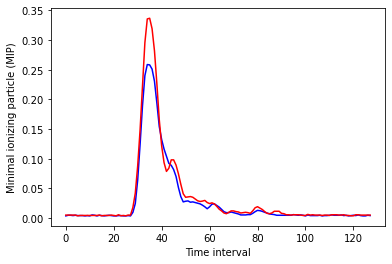

In [45]:
a=train[20,:,0]
b=train[20,:,1]
plt.subplots(1,1,figsize=(6,4))
plt.plot(a,'b')
plt.plot(b,'r')
plt.xlabel("Time interval")
plt.ylabel('Minimal ionizing particle (MIP)')
plt.savefig('dip_1.png')

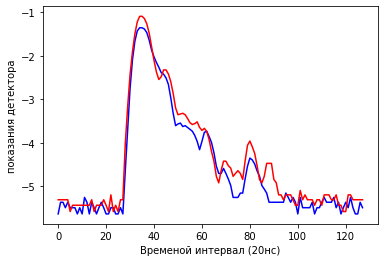

In [78]:
a=np.log(train[20,:,0])
b=np.log(train[20,:,1])
plt.plot(a,'b')
plt.plot(b,'r')
plt.xlabel("Временой интервал (20нс)")
plt.ylabel('показания детектора')
plt.savefig('dip_1.png')

[1.12229e+05 1.12466e+05 5.40300e+04 3.83330e+04 2.94010e+04 2.38960e+04
 1.96670e+04 1.63520e+04 1.38520e+04 1.21030e+04 1.03090e+04 8.57200e+03
 6.95500e+03 5.51200e+03 3.90900e+03 2.49200e+03 1.40700e+03 6.47000e+02
 1.66000e+02 2.20000e+01] [0.   0.05 0.1  0.15 0.2  0.25 0.3  0.35 0.4  0.45 0.5  0.55 0.6  0.65
 0.7  0.75 0.8  0.85 0.9  0.95 1.  ]


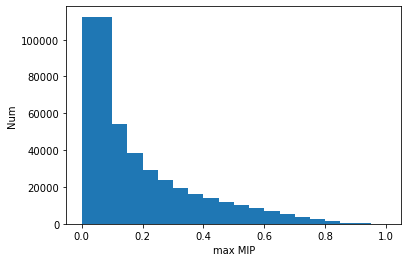

In [5]:
max_el=np.zeros(len(train))
for i in range(len(train)):
    max_el[i]=train[i].max()
    
# print(len(max_el))    
num,interval,pl=plt.hist(max_el,20,(0,1))
plt.xlabel('max MIP')
plt.ylabel('Num')
plt.savefig('real_hist.png')
print(num,interval)

In [24]:
with h5py.File("mc_wfmax_norm.h5",'r') as f:
    print(list(f.keys()))
    norm_param=f['norm_param'][:]
    test=f['test'][:]
    train=f['train'][:472320]
    print(f['train'].shape)
# mean=train.mean()
# train=train-mean
# train=train/(np.absolute(train)).max()
train=(train+1)/2
test=(test+1)/2
print(train.min(),train.max(),train.mean())
print(len(train))
print(norm_param)
trian=test
train_huge=train[train.max(axis=1).max(axis=1)>0.2]
train.shape
# train=train[:2425*64]

train_small_list=train_small(train,weights=np.array([1.12229e+05, 1.12466e+05, 5.40300e+04, 3.83330e+04])/ 2.94010e+04,threshold=0.2,step=0.05)   
train=np.append(train_small_list,train_huge,axis=0)
np.random.shuffle(train)
train.shape

['norm_param', 'test', 'train']
(472351, 128, 2)
0.0 1.0 0.025971571
472320
[[ 0.04490717  0.04396976]
 [-0.99174523 -0.9909725 ]]


100%|██████████| 472320/472320 [00:08<00:00, 58961.42it/s]


(272742, 128, 2)

In [23]:
def train_small(train,weights,threshold=0.2,step=0.05):
    intervals=np.arange(0,threshold+step,step)
    train_small_list=[]
    for train_one in tqdm.tqdm(train):
        for i in range(len(intervals)-1):
            if intervals[i]<train_one.max()<=intervals[i+1]:
                if random.random()<1/weights[i]:
                    train_small_list.append(train_one)
    return train_small_list
                
# train_small(train,weights=np.array([1.12229e+05, 1.12466e+05, 5.40300e+04, 3.83330e+04])/ 2.94010e+04,threshold=0.2,step=0.05)       

In [6]:
def return_data():
    with h5py.File("mc_wfmax_norm.h5",'r') as f:
        print(list(f.keys()))
        norm_param=f['norm_param'][:]
        test=f['test'][:]
        train=f['train'][:472320]
        print(f['train'].shape)
    # mean=train.mean()
    # train=train-mean
    # train=train/(np.absolute(train)).max()
    train=(train+1)/2
    test=(test+1)/2
    np.random.shuffle(train)
    train_huge=train[train.max(axis=1).max(axis=1)>0.2]
    train.shape
    train=train[:2425*64]
    train_small=train[train.max(axis=1).max(axis=1)<0.2][:(25000//64)*64+2]
    train=np.append(train_small,train_huge,axis=0)
    np.random.shuffle(train)
    train.shape
    return (train,test)
train,test=return_data()

['norm_param', 'test', 'train']
(472351, 128, 2)


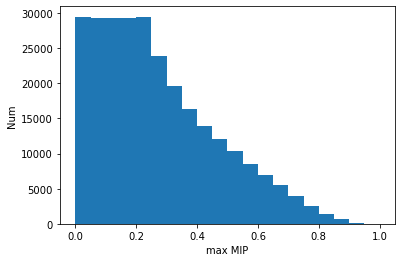

In [25]:
max_el=np.zeros(len(train))
for i in range(len(train)):
    max_el[i]=train[i].max()
    
# print(len(max_el))    
num,interval,pl=plt.hist(max_el,20,(0,1))
plt.xlabel('max MIP')
plt.ylabel('Num')
plt.savefig('real_hist.png')

In [2]:
# Самые перспективные модели
i=2
seccessful_models=['with_CONV2_real','with_noise_198','with_Conv2','without_average','BA/WGAN_not_agr_mean_kern2']
gen_n=f'{seccessful_models[i]}/save_model/generator/ep0'
gen=tf.keras.models.load_model(gen_n)
noise=[200,398,233,200,200] #шум для каждоей моделе по опроядку. Потом завернуть в словарь
gen.summary()

Model: "Generator_model_"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 233)]        0                                            
__________________________________________________________________________________________________
tf.__operators__.getitem (Slici (None, 200)          0           input_1[0][0]                    
__________________________________________________________________________________________________
dense (Dense)                   (None, 200)          40000       tf.__operators__.getitem[0][0]   
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 200)          800         dense[0][0]                      
___________________________________________________________________________________

In [4]:
# Самые перспективные модели
i=2
seccessful_models=['with_CONV2_real','with_noise_198','with_Conv2','without_average','BA/WGAN_not_agr_mean_kern2']
disc_n=f'{seccessful_models[i]}/save_model/discriminator/ep0'
disc=tf.keras.models.load_model(disc_n)
noise=[200,398,233,200,200] #шум для каждоей моделе по опроядку. Потом завернуть в словарь
disc.summary()

Model: "Discriminator_model_num_"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 128, 2)]          0         
_________________________________________________________________
zero_padding1d (ZeroPadding1 (None, 148, 2)            0         
_________________________________________________________________
first (Conv1D)               (None, 148, 32)           352       
_________________________________________________________________
max_pooling1d (MaxPooling1D) (None, 74, 32)            0         
_________________________________________________________________
dropout_6 (Dropout)          (None, 74, 32)            0         
_________________________________________________________________
leaky_re_lu_6 (LeakyReLU)    (None, 74, 32)            0         
_________________________________________________________________
conv1d (Conv1D)              (None, 74, 64

In [34]:
#copy Most active detector
def Discriminator_model(num=''):
    input_tensor=tf.keras.Input(shape=(128,2))
    x= input_tensor
    
    x=tf.keras.layers.ZeroPadding1D(10)(x)
#     x=tf.keras.layers.Conv1D(filters=32, kernel_size=(5), strides=(1), padding='same')(x)
#     x=tf.keras.layers.LeakyReLU()(x)

    x=tf.keras.layers.Conv1D(filters=32, kernel_size=(5), strides=(1), padding='same',name="first")(x)
    x=tf.keras.layers.MaxPooling1D(2,padding='same')(x)
    x=tf.keras.layers.Dropout(rate=0.2)(x)
    x=tf.keras.layers.LeakyReLU()(x)
    x=tf.keras.layers.Conv1D(filters=64, kernel_size=(5), strides=(1), padding='same')(x)
    x=tf.keras.layers.MaxPooling1D(2,padding='same')(x)
    x=tf.keras.layers.Dropout(rate=0.2)(x)
    x=tf.keras.layers.LeakyReLU()(x)
    
    x=tf.keras.layers.Conv1D(filters=64, kernel_size=(5), strides=(1), padding='same')(x)
    x=tf.keras.layers.MaxPooling1D(2,padding='same')(x)
    x=tf.keras.layers.Dropout(rate=0.2)(x)
    x=tf.keras.layers.LeakyReLU()(x)
    
    x=tf.keras.layers.Conv1D(filters=64, kernel_size=(5), strides=(1), padding='same')(x)# kern=4
    x=tf.keras.layers.MaxPooling1D(2,padding='same')(x)
    x=tf.keras.layers.Dropout(rate=0.2)(x)
    x=tf.keras.layers.LeakyReLU()(x)
    
    x=tf.keras.layers.Conv1D(filters=128, kernel_size=(5), strides=(1), padding='same')(x)# kern=4
    x=tf.keras.layers.MaxPooling1D(2,padding='same')(x)
    x=tf.keras.layers.Dropout(rate=0.2)(x)
    x=tf.keras.layers.LeakyReLU()(x)
    
    x=tf.keras.layers.Flatten()(x)
    x=tf.keras.layers.Dropout(rate=0.1)(x)

    x=tf.keras.layers.Dense(units=100,activation='relu')(x)
    x=tf.keras.layers.Dense(units=1)(x)
    
    model= tf.keras.Model(input_tensor,x,name="Discriminator_model_num_{}".format(num))
    return model

discriminator=Discriminator_model()

discriminator.summary()
# tf.keras.utils.plot_model(discriminator)

Model: "Discriminator_model_num_"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 128, 2)]          0         
_________________________________________________________________
zero_padding1d (ZeroPadding1 (None, 148, 2)            0         
_________________________________________________________________
first (Conv1D)               (None, 148, 32)           352       
_________________________________________________________________
max_pooling1d (MaxPooling1D) (None, 74, 32)            0         
_________________________________________________________________
dropout (Dropout)            (None, 74, 32)            0         
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 74, 32)            0         
_________________________________________________________________
conv1d (Conv1D)              (None, 74, 64

In [35]:
def Generator_model(num="",noise_dim=233): 
    input_tensor=tf.keras.Input(shape=(noise_dim,))
    x=tf.keras.layers.Dense(units=200,use_bias=False)(input_tensor[:,:200])
    x=tf.keras.layers.BatchNormalization()(x)
    x=tf.keras.layers.LeakyReLU()(x)
    
    x=tf.keras.layers.Dense(units=33*6,use_bias=False)(x)
    x=tf.keras.layers.Dropout(rate=0.1)(x)
    x=tf.keras.layers.BatchNormalization()(x)
    x=tf.keras.layers.LeakyReLU()(x)
    
    x=tf.keras.layers.Reshape((33,6,1))(x)
    
    y=(input_tensor[:,200:])
    b = tf.constant([1,1,6,1], tf.int32)
    y=tf.keras.layers.Reshape((33,1,1))(y)
    
    y=tf.tile(y,b)
    
    x=tf.keras.layers.concatenate([x,y])
    x=tf.keras.layers.Conv2DTranspose(128, (5,4), strides=(2,1), padding='same', use_bias=False,data_format='channels_last')(x)
    x=tf.keras.layers.Dropout(rate=0.1)(x)
    x=tf.keras.layers.BatchNormalization()(x)
    x=tf.keras.layers.LeakyReLU()(x)
    
    x=tf.keras.layers.Conv2DTranspose(64, (5,2), strides=(2,1), padding='same', use_bias=False,data_format='channels_last')(x)
    x=tf.keras.layers.Dropout(rate=0.1)(x)
    x=tf.keras.layers.BatchNormalization()(x)
    x=tf.keras.layers.LeakyReLU()(x)
#     print(x.shape)


    x=tf.keras.layers.Conv2D(32, (5,1), strides=(1,1), padding='same', use_bias=False,data_format='channels_last',name="befor_concat")(x)
    x=tf.keras.layers.Dropout(rate=0.1)(x)
#     x=tf.keras.layers.AveragePooling2D((2,1),padding='same')(x)
    x=tf.keras.layers.BatchNormalization()(x)
    x=tf.keras.layers.LeakyReLU()(x)
    
#     y=tf.keras.layers.Dense(units=264*6*1,use_bias=False)(input_tensor[100:])
#     y=tf.random.normal((132,6,4))
#     y=tf.keras.layers.Reshape((132,6,4))(y)
#     x=tf.keras.layers.concatenate([x,y])
    
#     x=tf.keras.layers.Conv2DTranspose(16, (5,1), strides=(2,1), padding='same', use_bias=False,data_format='channels_last')(x)
#     x=tf.keras.layers.Dropout(rate=0.1)(x)
#     x=tf.keras.layers.BatchNormalization()(x)
#     x=tf.keras.layers.LeakyReLU()(x)

    
    x=tf.keras.layers.Conv2DTranspose(8, (5,2), strides=(2,1), padding='same', use_bias=False,data_format='channels_last')(x)
    x=tf.keras.layers.Dropout(rate=0.1)(x)
    x=tf.keras.layers.BatchNormalization()(x)
    x=tf.keras.layers.LeakyReLU()(x)
    x=tf.keras.layers.AveragePooling2D((2,1),padding='same')(x)
    
    
#     y=input_tensor[:,200:]
#     y=tf.keras.layers.Reshape((132,6,1))(y)
#     x=tf.keras.layers.concatenate([x,y])
    x=tf.keras.layers.Conv2D(1, (5,2), strides=(1,1), padding='same', use_bias=False,data_format='channels_last')(x)
    x=tf.keras.layers.Dropout(rate=0.1)(x)
    x=tf.keras.layers.BatchNormalization()(x)
    x=tf.keras.activations.sigmoid(x)
    x=tf.keras.layers.Cropping2D((2,2))(x) #change
    x=tf.keras.layers.Reshape((128,2))(x)

    model= tf.keras.Model(input_tensor,x,name="Generator_model_{}".format(num))
#     assert model.output_shape == (None, 128, 2, 1)
    return model
# kern 3,4,5,5,|^ 
# kern (n,2)
generator=Generator_model()
generator.summary()
# tf.keras.utils.plot_model(generator)

Model: "Generator_model_"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 233)]        0                                            
__________________________________________________________________________________________________
tf.__operators__.getitem_2 (Sli (None, 200)          0           input_2[0][0]                    
__________________________________________________________________________________________________
dense_2 (Dense)                 (None, 200)          40000       tf.__operators__.getitem_2[0][0] 
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 200)          800         dense_2[0][0]                    
___________________________________________________________________________________

In [91]:
def generat_new_data(batch):
    noise=tf.random.normal(shape=(batch,noise_dim))
    #n_scal=tf.random.normal(shape=(batch,scal_dim))#change
    data=generator(noise)#*scal(n_scal)#change
    return (data)



def discriminator_loss(real_output, fake_output):
#     real_loss = loss_function(tf.ones_like(real_output), real_output)
#     fake_loss = loss_function(tf.zeros_like(fake_output), fake_output)
    real_loss = -tf.reduce_mean(real_output)
    fake_loss = tf.reduce_mean(fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

def generator_loss(fake_output):
#     return loss_function(tf.ones_like(fake_output), fake_output)
    return -tf.reduce_mean(fake_output)

def gradient_penalti(batch,real_data,fake_data):
#   alpha = tf.random.normal([batch, 1], 0.0, 1.0)
#   diff = fake_data - real_data
#   interpolated = real_data + alpha * diff
    epsilon=tf.random.uniform(shape=(batch,1,1),dtype=tf.dtypes.float32)
    interpolated=real_data-epsilon*(real_data-fake_data)# вычисление x^ как в статье
    with tf.GradientTape() as gp_tape:
        gp_tape.watch(interpolated)
        pred=discriminator(interpolated,training=True)  # D(x^)
    grads = gp_tape.gradient(pred, [interpolated])[0]# because list
    norm = tf.sqrt(tf.reduce_sum(tf.square(grads), axis=[1]))
    gp = tf.reduce_mean((norm - 1.0) ** 2)
    return gp    


In [102]:
@tf.function
def train_step_WGAN(labda,batch,real_data,weight_gp,weight_corr):
  # labda --> number learling critic
  #weight --> weight gradient_penalti

  #learning critic
    for i in range(labda):
        with tf.GradientTape() as gr:
            noise = tf.random.normal(shape=(batch,noise_dim))
            fake_data=generator(noise)#change
#             print('f')
            real_data=real_data
            fake_predict=discriminator(fake_data)
            real_predict=discriminator(real_data)
            real_data=tf.cast(real_data,dtype=tf.float32)
            gp=gradient_penalti(batch,real_data,fake_data)
            disc_loss=discriminator_loss(real_predict,fake_predict)+weight_gp*gp # critic loss include GP
        d_grad=gr.gradient(disc_loss, discriminator.trainable_variables)
        discriminator_optimizer.apply_gradients(zip(d_grad, discriminator.trainable_variables))


  #learning generator
    noise = tf.random.normal(shape=(batch,noise_dim))
    with tf.GradientTape() as gr:
        fake_data=generator(noise)
        fake_predict=discriminator(fake_data)
#         corr_loss=correletion_loss(fake_data)
        gen_loss=generator_loss(fake_predict)# +weight_corr*corr_loss
    
    
    
    
    g_grad=gr.gradient(gen_loss,generator.trainable_variables)
    generator_optimizer.apply_gradients(zip(g_grad, generator.trainable_variables))
    return (gen_loss,disc_loss)


In [85]:
num=30
noise = tf.random.normal(shape=(num,noise_dim))
data_fake=generator(noise)
data_real=test[:num]
print(data_fake.shape,data_real.shape)
predict_fake=discriminator(data_fake)

(30, 128, 2) (30, 128, 2)


In [89]:
import os
dir_name="best_models/with_noise_198"
os.mkdir(dir_name)
os.mkdir('{}/save_images'.format(dir_name))
os.mkdir('{}/save_model'.format(dir_name))

  7%|▋         | 200/3000 [00:06<01:34, 29.64it/s]


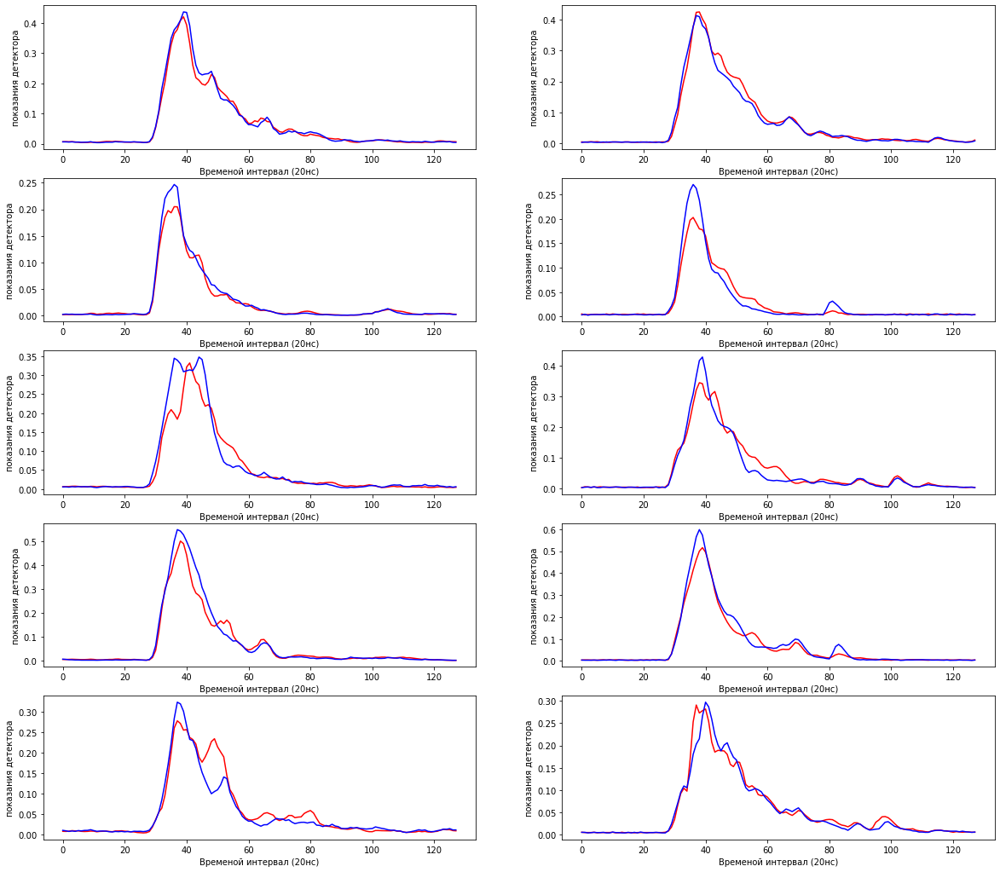

In [109]:

generator=tf.keras.models.load_model('best_models/with_noise_198/save_model/generator/ep'+str(0))
discriminator=tf.keras.models.load_model('best_models/with_noise_198/save_model/discriminator/ep'+str(0))
def image(n,num=10):
    fig, axes =plt.subplots(num,2,figsize=(20,18))
    
    i=0
    while i < num:
        
        j=random.randint(0,len(train))
        if train[j].max()>0.2:
            axes[i,1].plot(train[j,:,1],'r')
            axes[i,1].plot(train[j,:,0],'b')
            axes[i,1].set_xlabel("Временой интервал (20нс)")
            axes[i,1].set_ylabel('показания детектора')


    #         noise = tf.random.normal(shape=(1,noise_dim))
            noise=find_noise(generator,discriminator,image=np.array([train[j]]),noise_dim=200+198)[0]
            axes[i,0].plot((generator(noise))[0,:,1],'r')#change
            axes[i,0].plot((generator(noise))[0,:,0],'b')

            axes[i,0].set_xlabel("Временой интервал (20нс)")
            axes[i,0].set_ylabel('показания детектора')
            i+=1
#             m=metric(generator,discriminator,np.array([train[j]]),noise_dim=200+198,batch=64,k_rd=0.0001,name='???')
#             axes[i,0].text(100,int(train[j].max()*0.2),f'metric : {round(m,3)}')
#         plt.suptitle("epoch:"+str(n))
#         plt.savefig("{}/save_images/epoch{}.png".format(dir_name,n))
    
image(5,5)

In [ ]:
metric(generator,discriminator,train[:2000],noise_dim=398,batch=64,k_rd=0.0001,name='???')

In [ ]:
batch=64
generator=tf.keras.models.load_model('with_noise_198/save_model/generator/ep'+str(0))
discriminator=tf.keras.models.load_model('with_noise_198/save_model/discriminator/ep'+str(0))
epochs=50
ep_start=0
noise_dim=398
g_list=[]
d_list=[]
def train_WGAN(epochs,train_data,batch):
    plt.figure()
    for j in tqdm_notebook(range(ep_start,epochs),'ep'):
        for num in range (0,len(train_data),batch):
            step_data=train_data[num:num+batch]
            g,d=train_step_WGAN(labda=5,batch=batch,real_data=step_data,weight_gp=10,weight_corr=1)
            d_list.append(d)
            g_list.append(g)
#             disc_loss_list.append(disc_loss)
#             gen_loss_list.append(gen_loss)
            #corr_loss_list1.append(corr_loss)
#         generator.save("del")
#         if (j % 10 == 0):
#             image(j)
        discriminator.save("{}/save_model/discriminator/ep{}".format(dir_name,j))
        generator.save("{}/save_model/generator/ep{}".format(dir_name,j))
train_WGAN(epochs,train,batch)

INFO:tensorflow:Assets written to: best_models/with_noise_198/save_model/discriminator/ep0/assets


INFO:tensorflow:Assets written to: best_models/with_noise_198/save_model/discriminator/ep0/assets


INFO:tensorflow:Assets written to: best_models/with_noise_198/save_model/generator/ep0/assets


INFO:tensorflow:Assets written to: best_models/with_noise_198/save_model/generator/ep0/assets


INFO:tensorflow:Assets written to: best_models/with_noise_198/save_model/discriminator/ep1/assets


INFO:tensorflow:Assets written to: best_models/with_noise_198/save_model/discriminator/ep1/assets


INFO:tensorflow:Assets written to: best_models/with_noise_198/save_model/generator/ep1/assets


INFO:tensorflow:Assets written to: best_models/with_noise_198/save_model/generator/ep1/assets


INFO:tensorflow:Assets written to: best_models/with_noise_198/save_model/discriminator/ep2/assets


INFO:tensorflow:Assets written to: best_models/with_noise_198/save_model/discriminator/ep2/assets


INFO:tensorflow:Assets written to: best_models/with_noise_198/save_model/generator/ep2/assets


INFO:tensorflow:Assets written to: best_models/with_noise_198/save_model/generator/ep2/assets


INFO:tensorflow:Assets written to: best_models/with_noise_198/save_model/discriminator/ep3/assets


INFO:tensorflow:Assets written to: best_models/with_noise_198/save_model/discriminator/ep3/assets


INFO:tensorflow:Assets written to: best_models/with_noise_198/save_model/generator/ep3/assets


INFO:tensorflow:Assets written to: best_models/with_noise_198/save_model/generator/ep3/assets


In [ ]:

df=pd.DataFrame(columns=['name','metric'])
for s in os.listdir('BA'):
    generator=tf.keras.models.load_model('BA/{}/save_model/generator/ep20'.format(s))
    discriminator=tf.keras.models.load_model('BA/{}/save_model/discriminator/ep20'.format(s))
    m=metric(generator,discriminator,test[:2000],128,name=s)
    df_new=pd.DataFrame([[s,m]],columns=['name','metric'])
    df=pd.concat([df,df_new])
df.to_csv('metric.csv')
        

In [118]:
df.sort_values('metric')

,name,metric
0,WGAN_not_agr_mean_kern2,0.001826
0,WGAN_not_agr_mean_kern2_2,0.001847
0,WGAN_not_agr,0.001956
0,WGAN_not_agr_mean3,0.002209
0,WGAN_agr_mean(all_51),0.002268
0,WGAN_not_agr_mean_kern4,0.002296
0,WGAN_not_agr_mean,0.002544
0,WGAN_not_agr3,0.002589
0,WGAN_not_agr6,0.002662
0,WGAN_not_agr_mean3_(|^),0.002839


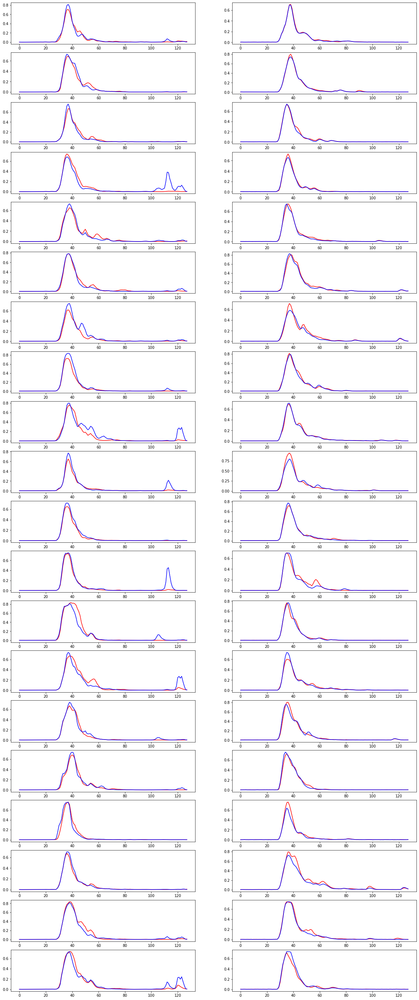

In [123]:
i=20
generator=tf.keras.models.load_model('BA/WGAN_not_agr_mean3/save_model/generator/ep'+str(i))
noise_dim=200
noise = tf.random.normal(shape=(2000,noise_dim))
data=generator(noise)

def big_ampl(por:set,z:int):
    fig, axes =plt.subplots(z,2,figsize=(20,50))
    j=0
    por_min, por_max=por 
    for i in range(len(data)):
        if (tf.math.reduce_max(data[i])>por_min and tf.math.reduce_max(data[i])<por_max) :
            axes[j,0].plot(data[i][:,1],'r')#change
            axes[j,0].plot(data[i][:,0],'b')
            j+=1
            if j>z-1:
                break
    j=0
    
    q=random.randint(0,len(train)//2)
    for i in range(q,len(train)):
        if (tf.math.reduce_max(train[i])>por_min and tf.math.reduce_max(train[i])<por_max):
            axes[j,1].plot(train[i][:,1],'r')#change
            axes[j,1].plot(train[i][:,0],'b')
            j+=1
            if j>z-1:
                break
big_ampl((0.7,1),20) 

In [1]:
generator=tf.keras.models.load_model('WGAN_3/save_model/generator/ep280')
noise = tf.random.normal(shape=(2000,noise_dim))
data=generator(noise)
max_el=np.zeros(len(data))
for i in range(len(data)):
    max_el[i]=tf.math.reduce_max(data[i])
    
# print(len(max_el))    
plt.hist(max_el,20,(0,1))
plt.xlabel('max MIP')
plt.ylabel('Num')
plt.savefig('fake_hist.png')

NameError: name 'tf' is not defined

## for check 

In [25]:

generator=tf.keras.models.load_model('BA/WGAN_not_agr_mean_kern2/save_model/generator/ep20')
discriminator=tf.keras.models.load_model('BA/WGAN_not_agr_mean_kern2/save_model/discriminator/ep20')
# generator=tf.keras.models.load_model('noise/200/save_model/generator/ep20')
# discriminator=tf.keras.models.load_model('noise/200/save_model/discriminator/ep20')
metric(generator,discriminator,test[:2000],128,name='200')

200: 100%|██████████| 16/16 [24:03<00:00, 90.22s/it]


0.0018455579741013363

In [10]:
generator=tf.keras.models.load_model('BA/WGAN_not_agr_mean_kern2/save_model/generator/ep20')
noise_dim=200
noise = tf.random.normal(shape=(2000,noise_dim))
data=generator(noise)
max_el=np.zeros(len(data))
for i in range(len(data)):
    max_el[i]=tf.math.reduce_max(data[i])
    
# print(len(max_el))    
plt.hist(max_el,20,(0,1))
plt.xlabel('max MIP')
plt.ylabel('Num')
# plt.savefig('fake_hist.png')

KeyboardInterrupt: 

In [22]:
generator=tf.keras.models.load_model('WGAN_2/save_model/generator/ep490')
noise_dim=200
noise = tf.random.normal(shape=(2000,noise_dim))
data=generator(noise)
max_el=np.zeros(len(data))
for i in range(len(data)):
    max_el[i]=tf.math.reduce_max(data[i])
    
# print(len(max_el))    
plt.hist(max_el,20,(0,1))
plt.xlabel('max MIP')
plt.ylabel('Num')
# plt.savefig('fake_hist.png')

OSError: SavedModel file does not exist at: WGAN_2/save_model/generator/ep490/{saved_model.pbtxt|saved_model.pb}

## Проверка гениротора и дискриминатора

In [29]:
generator=tf.keras.models.load_model('BA/WGAN_not_agr3/save_model/generator/ep20')
discriminator=tf.keras.models.load_model('BA/WGAN_not_agr3/save_model/discriminator/ep20')
noise_dim=200
num=5000
noise = tf.random.normal(shape=(num,noise_dim))
data_fake=generator(noise)
data_real=test[:num]
print(data_fake.shape,data_real.shape)
predict_fake=discriminator(data_fake)
predict_real=discriminator(data_real)
print(tf.reduce_mean(predict_fake),tf.reduce_mean(predict_real))

(5000, 128, 2) (5000, 128, 2)
tf.Tensor(24.374641, shape=(), dtype=float32) tf.Tensor(24.467522, shape=(), dtype=float32)


## Обучение только дискриминатора

In [22]:
generator=tf.keras.models.load_model('NOT_WGAN_2/save_model/generator/ep490')
# discriminator=tf.keras.models.load_model('NOT_WGAN_2/save_model/discriminator/ep0')
@tf.function
def train_step_WGAN_only_disc(labda,batch,real_data,weight_gp,weight_corr):
  # labda --> number learling critic
  #weight --> weight gradient_penalti

  #learning critic
    for i in range(labda):
        with tf.GradientTape() as gr:
            noise = tf.random.normal(shape=(batch,noise_dim))
            fake_data=generator(noise)#change
#             print('f')
            real_data=real_data
            fake_predict=discriminator(fake_data)
            real_predict=discriminator(real_data)
            real_data=tf.cast(real_data,dtype=tf.float32)
            gp=gradient_penalti(batch,real_data,fake_data)
            disc_loss=discriminator_loss(real_predict,fake_predict)#+weight_gp*gp # critic loss include GP
        
        discriminator_optimizer.apply_gradients(zip(d_grad, discriminator.trainable_variables))


  
    return (disc_loss)
# import os
# os.mkdir('GAN_only_disc')
# os.mkdir('GAN_only_disc/save_images')
# os.mkdir('GAN_only_disc/save_model')
batch=64
epochs=501
ep_start=0
g_list=[]
d_list=[]
discriminator=tf.keras.models.load_model('NOT_WGAN_2/save_model/discriminator/ep200')
def train_WGAN_only_disc(epochs,train_data,batch):
    plt.figure()
    for j in tqdm_notebook(range(ep_start,epochs),'ep'):
        for num in range (0,len(train_data),batch):
            step_data=train_data[num:num+batch]
            d=train_step_WGAN_only_disc(labda=1,batch=batch,real_data=step_data,weight_gp=10,weight_corr=1)
            d_list.append(d)
#         if j % 10 == 0:
#             image(j)
#             discriminator.save("GAN_4_only_disc/save_model/discriminator/ep"+str(j))
train_WGAN_only_disc(epochs,train,batch)


KeyboardInterrupt: 

<Figure size 432x288 with 0 Axes>

In [23]:
disc=tf.keras.models.load_model('GAN_RNN/save_model/discriminator/ep150')
disc.summary()

Model: "Discriminator_model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_6 (InputLayer)         [(None, 128, 2)]          0         
_________________________________________________________________
zero_padding1d_5 (ZeroPaddin (None, 148, 2)            0         
_________________________________________________________________
conv1d_20 (Conv1D)           (None, 37, 64)            1344      
_________________________________________________________________
dropout_23 (Dropout)         (None, 37, 64)            0         
_________________________________________________________________
leaky_re_lu_20 (LeakyReLU)   (None, 37, 64)            0         
_________________________________________________________________
conv1d_21 (Conv1D)           (None, 19, 128)           82048     
_________________________________________________________________
dropout_24 (Dropout)         (None, 19, 128)   

In [64]:
discriminator=tf.keras.models.load_model('NOT_WGAN_2/save_model/discriminator/ep300')
noise_dim=200
num=5000
noise = tf.random.normal(shape=(num,noise_dim))
data_fake=generator(noise)
data_real=test[:2*num]
print(data_fake.shape,data_real.shape)
predict_fake=discriminator(data_fake)
predict_real=discriminator(data_real)
print(tf.reduce_mean(predict_fake),tf.reduce_mean(predict_real))

(5000, 128, 2) (10000, 128, 2)
tf.Tensor(95.3321, shape=(), dtype=float32) tf.Tensor(95.31681, shape=(), dtype=float32)


In [88]:
# Самые перспективные модели
i=0
seccessful_models=['with_CONV2_real','with_noise_198','with_Conv2','without_average','BA/WGAN_not_agr_mean_kern2']
seccessful_models=['with_CONV2_real']
gen_n=f'{seccessful_models[i]}/save_model/generator/ep0'
gen=tf.keras.models.load_model(gen_n)
noise_list=[200,398,233,200,200] #шум для каждоей моделе по опроядку. Потом завернуть в словарь
noise_dict={'with_CONV2_real':200,'with_noise_198':398,'with_Conv2':233,'without_average':200,'BA/WGAN_not_agr_mean_kern2':200}
gen.summary()

Model: "Generator_model_"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 200)]             0         
_________________________________________________________________
tf.__operators__.getitem (Sl (None, 200)               0         
_________________________________________________________________
dense (Dense)                (None, 200)               40000     
_________________________________________________________________
batch_normalization (BatchNo (None, 200)               800       
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 200)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 198)               39600     
_________________________________________________________________
dropout (Dropout)            (None, 198)          

INFO:tensorflow:Assets written to: seccessfuk_models/with_CONV2_real/save_model/discriminator/ep0/assets
INFO:tensorflow:Assets written to: seccessfuk_models/with_CONV2_real/save_model/generator/ep0/assets
INFO:tensorflow:Assets written to: seccessfuk_models/with_CONV2_real/save_model/discriminator/ep1/assets
INFO:tensorflow:Assets written to: seccessfuk_models/with_CONV2_real/save_model/generator/ep1/assets
INFO:tensorflow:Assets written to: seccessfuk_models/with_CONV2_real/save_model/discriminator/ep2/assets
INFO:tensorflow:Assets written to: seccessfuk_models/with_CONV2_real/save_model/generator/ep2/assets
INFO:tensorflow:Assets written to: seccessfuk_models/with_CONV2_real/save_model/discriminator/ep3/assets
INFO:tensorflow:Assets written to: seccessfuk_models/with_CONV2_real/save_model/generator/ep3/assets
INFO:tensorflow:Assets written to: seccessfuk_models/with_CONV2_real/save_model/discriminator/ep5/assets
INFO:tensorflow:Assets written to: seccessfuk_models/with_CONV2_real/sa

/home/rfit/.conda/envs/robert_venv/lib/python3.6/site-packages/ipykernel_launcher.py:88: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


INFO:tensorflow:Assets written to: seccessfuk_models/with_CONV2_real/save_model/discriminator/ep19/assets
INFO:tensorflow:Assets written to: seccessfuk_models/with_CONV2_real/save_model/generator/ep19/assets


/home/rfit/.conda/envs/robert_venv/lib/python3.6/site-packages/ipykernel_launcher.py:88: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


INFO:tensorflow:Assets written to: seccessfuk_models/with_CONV2_real/save_model/discriminator/ep20/assets
INFO:tensorflow:Assets written to: seccessfuk_models/with_CONV2_real/save_model/generator/ep20/assets


/home/rfit/.conda/envs/robert_venv/lib/python3.6/site-packages/ipykernel_launcher.py:88: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


INFO:tensorflow:Assets written to: seccessfuk_models/with_CONV2_real/save_model/discriminator/ep21/assets
INFO:tensorflow:Assets written to: seccessfuk_models/with_CONV2_real/save_model/generator/ep21/assets


/home/rfit/.conda/envs/robert_venv/lib/python3.6/site-packages/ipykernel_launcher.py:88: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


INFO:tensorflow:Assets written to: seccessfuk_models/with_CONV2_real/save_model/discriminator/ep22/assets
INFO:tensorflow:Assets written to: seccessfuk_models/with_CONV2_real/save_model/generator/ep22/assets


/home/rfit/.conda/envs/robert_venv/lib/python3.6/site-packages/ipykernel_launcher.py:88: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


INFO:tensorflow:Assets written to: seccessfuk_models/with_CONV2_real/save_model/discriminator/ep23/assets
INFO:tensorflow:Assets written to: seccessfuk_models/with_CONV2_real/save_model/generator/ep23/assets


/home/rfit/.conda/envs/robert_venv/lib/python3.6/site-packages/ipykernel_launcher.py:88: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


INFO:tensorflow:Assets written to: seccessfuk_models/with_CONV2_real/save_model/discriminator/ep24/assets
INFO:tensorflow:Assets written to: seccessfuk_models/with_CONV2_real/save_model/generator/ep24/assets


/home/rfit/.conda/envs/robert_venv/lib/python3.6/site-packages/ipykernel_launcher.py:88: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


INFO:tensorflow:Assets written to: seccessfuk_models/with_CONV2_real/save_model/discriminator/ep25/assets
INFO:tensorflow:Assets written to: seccessfuk_models/with_CONV2_real/save_model/generator/ep25/assets


/home/rfit/.conda/envs/robert_venv/lib/python3.6/site-packages/ipykernel_launcher.py:88: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


INFO:tensorflow:Assets written to: seccessfuk_models/with_CONV2_real/save_model/discriminator/ep26/assets
INFO:tensorflow:Assets written to: seccessfuk_models/with_CONV2_real/save_model/generator/ep26/assets


/home/rfit/.conda/envs/robert_venv/lib/python3.6/site-packages/ipykernel_launcher.py:88: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


INFO:tensorflow:Assets written to: seccessfuk_models/with_CONV2_real/save_model/discriminator/ep27/assets
INFO:tensorflow:Assets written to: seccessfuk_models/with_CONV2_real/save_model/generator/ep27/assets


/home/rfit/.conda/envs/robert_venv/lib/python3.6/site-packages/ipykernel_launcher.py:88: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


INFO:tensorflow:Assets written to: seccessfuk_models/with_CONV2_real/save_model/discriminator/ep28/assets
INFO:tensorflow:Assets written to: seccessfuk_models/with_CONV2_real/save_model/generator/ep28/assets


/home/rfit/.conda/envs/robert_venv/lib/python3.6/site-packages/ipykernel_launcher.py:88: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


INFO:tensorflow:Assets written to: seccessfuk_models/with_CONV2_real/save_model/discriminator/ep29/assets
INFO:tensorflow:Assets written to: seccessfuk_models/with_CONV2_real/save_model/generator/ep29/assets



<Figure size 432x288 with 0 Axes>

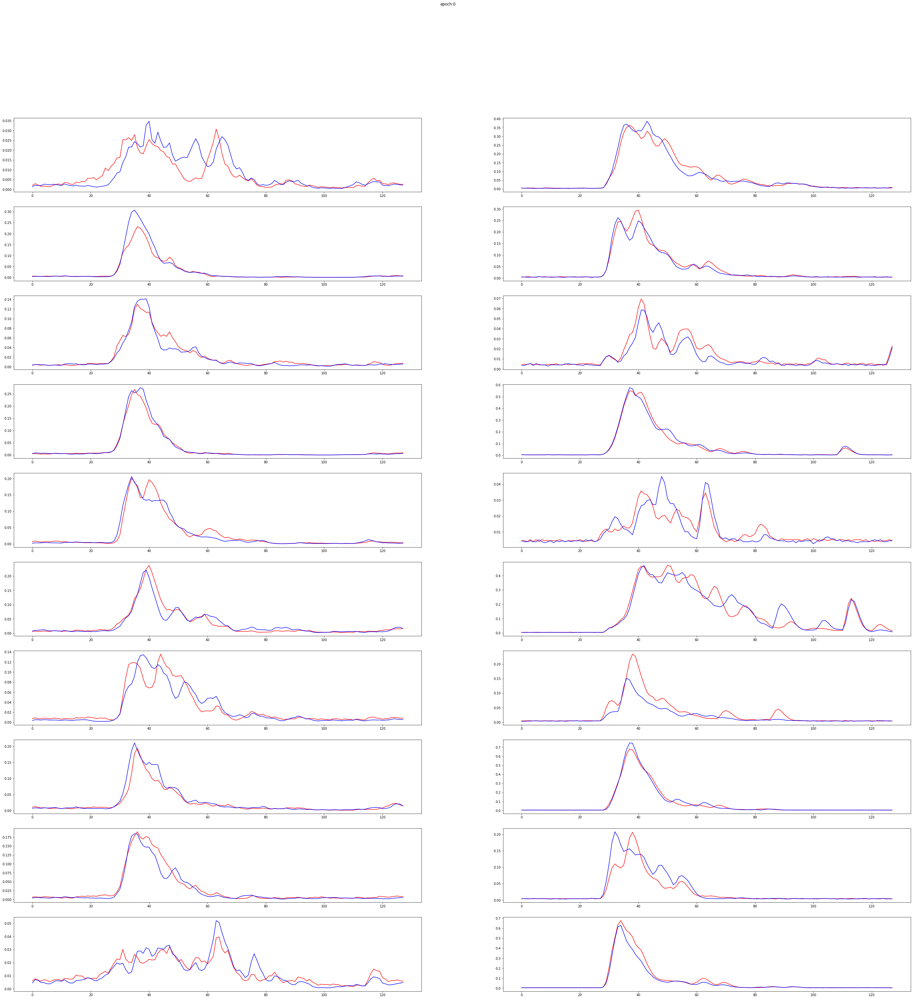

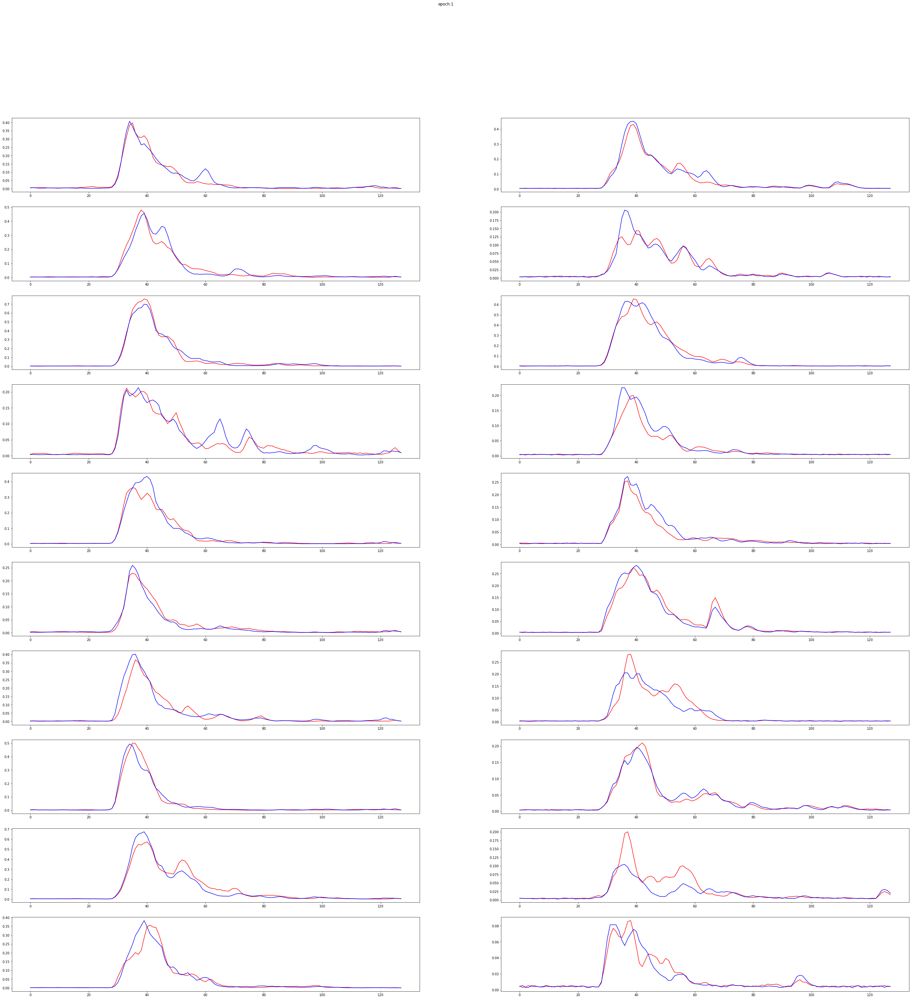

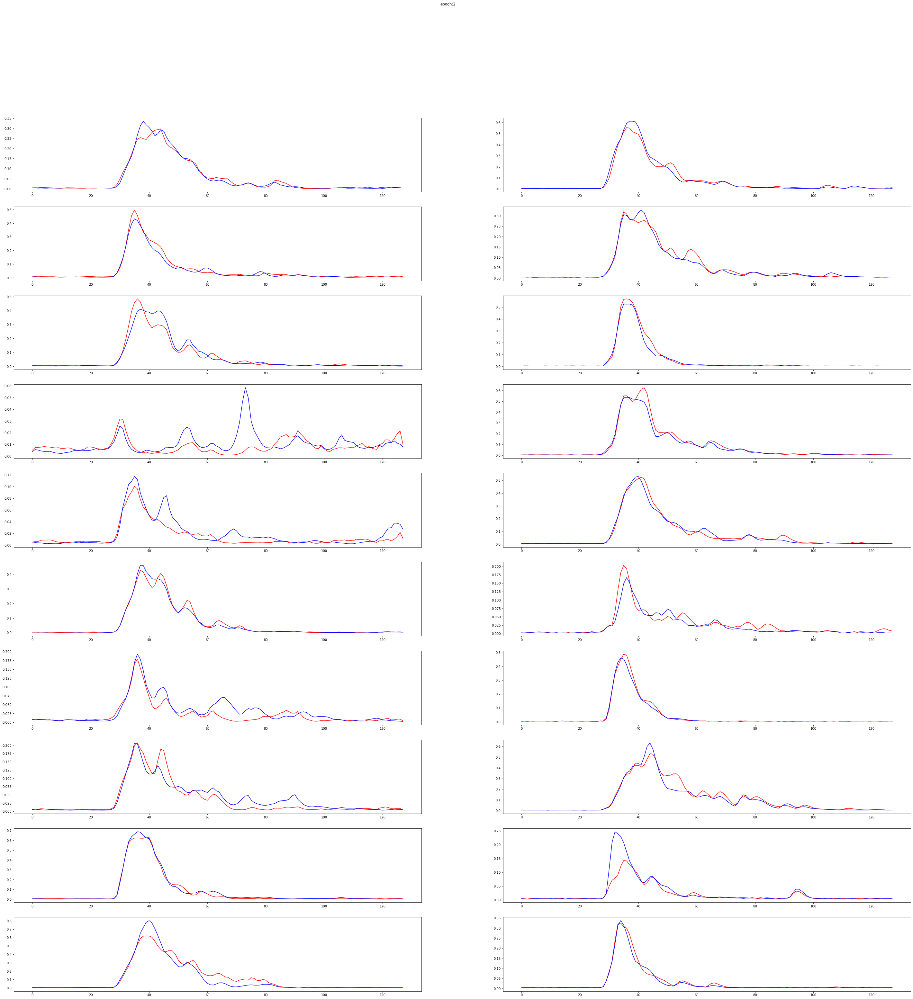

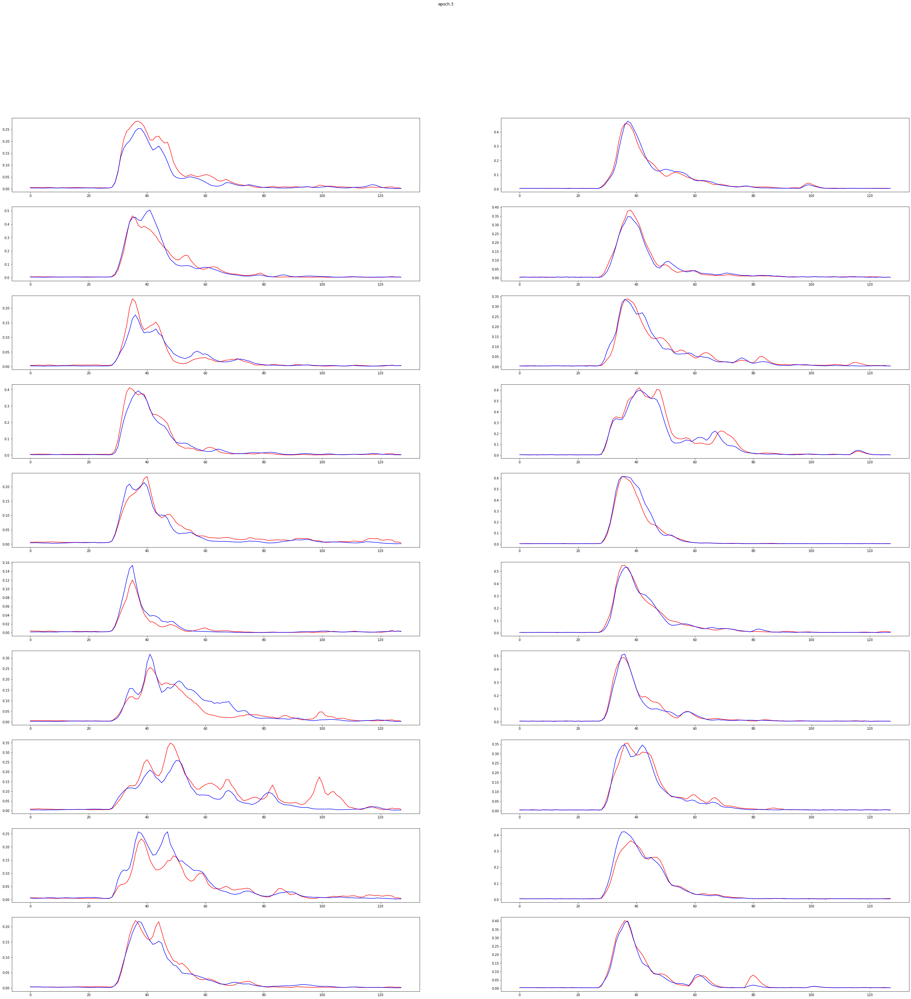

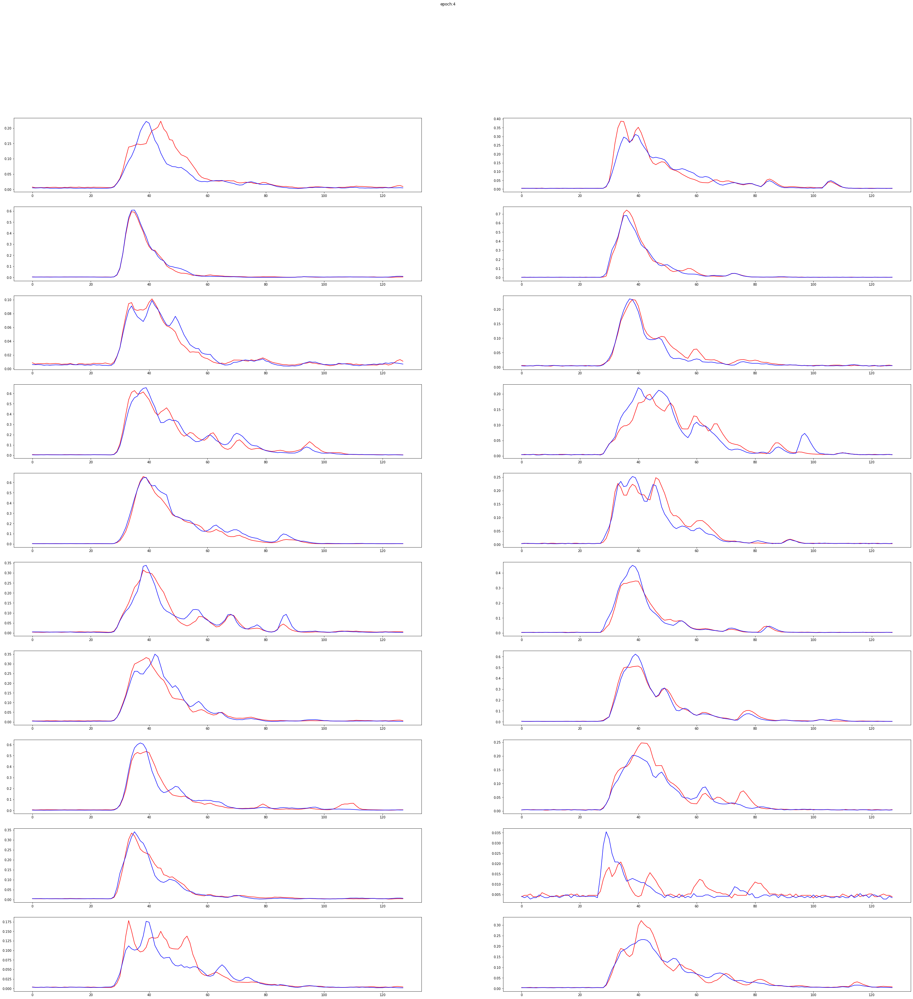

...

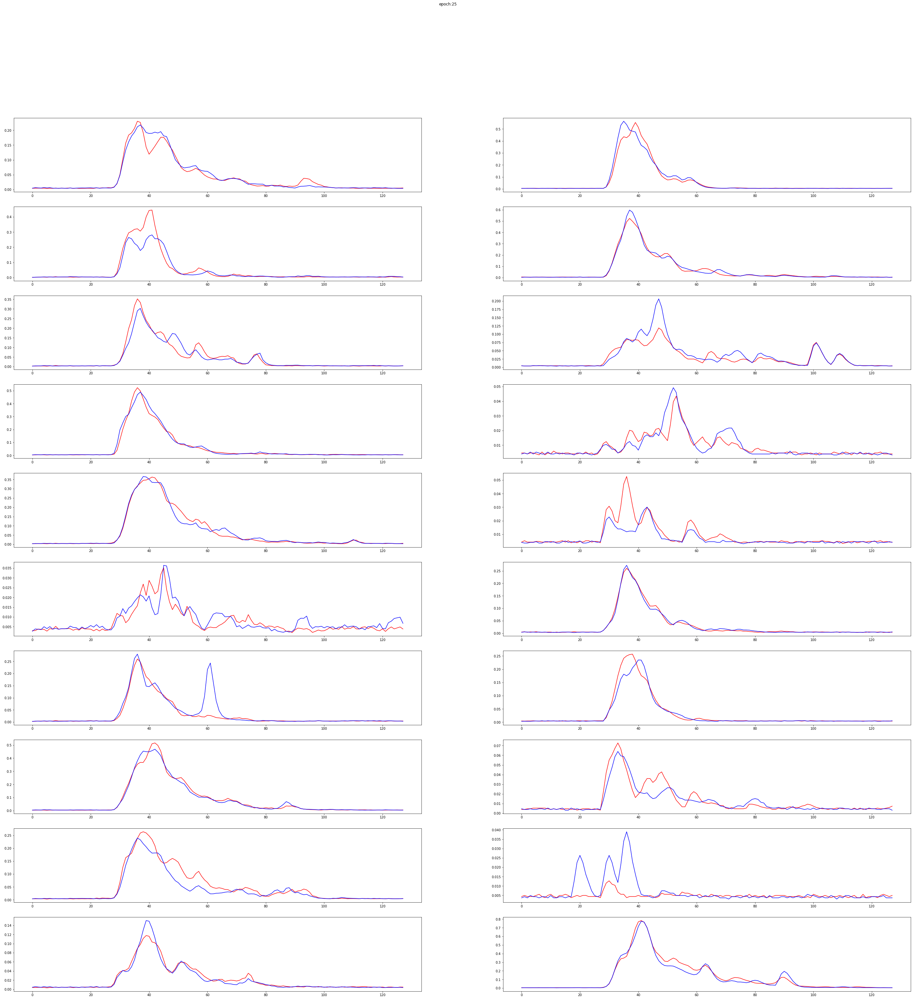

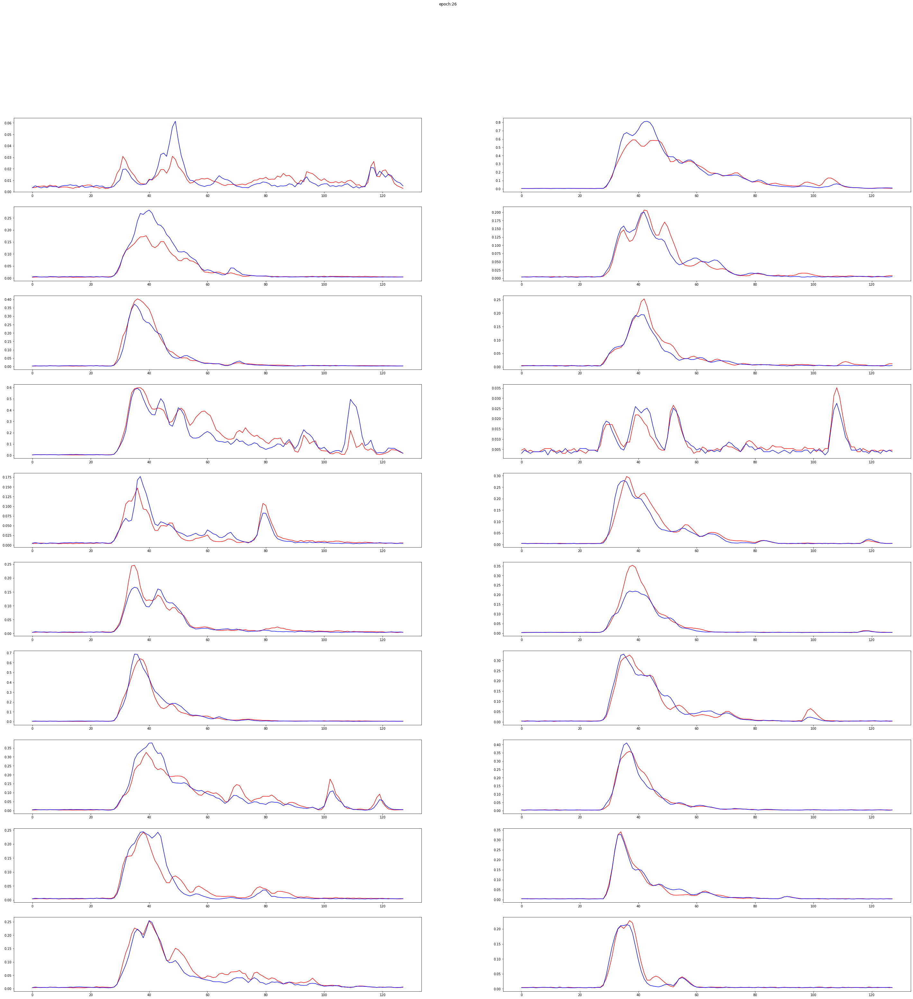

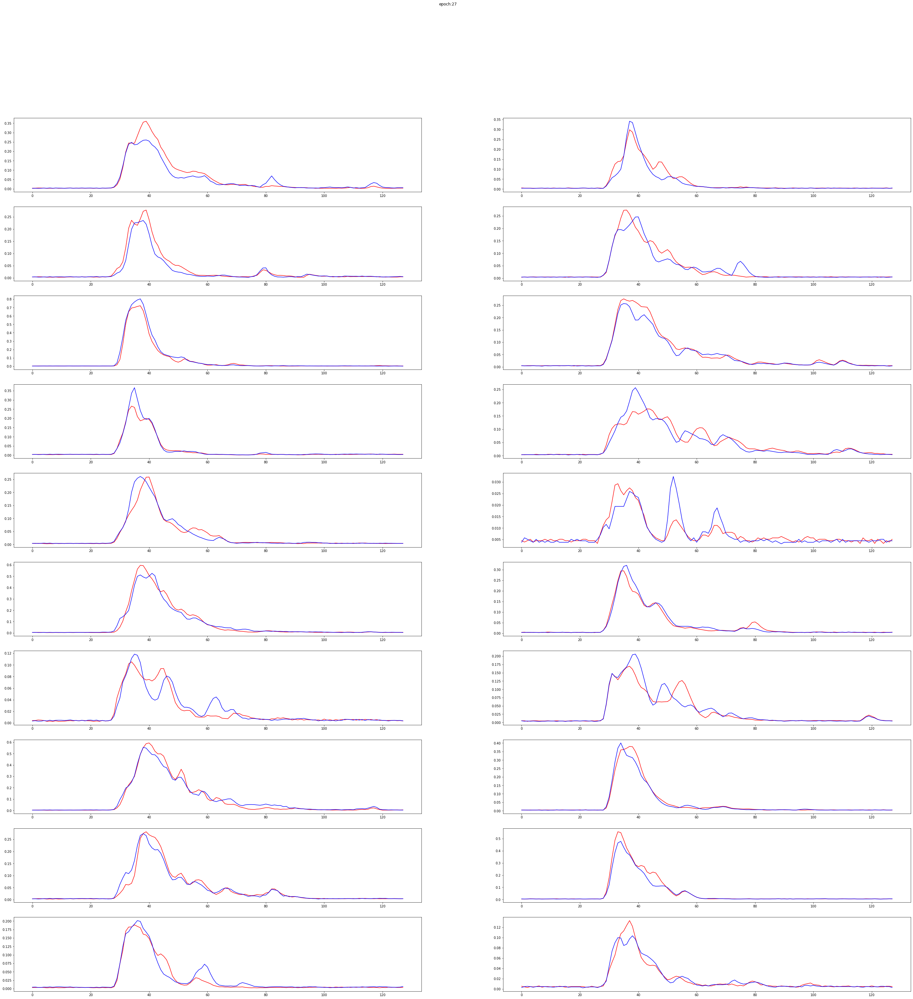

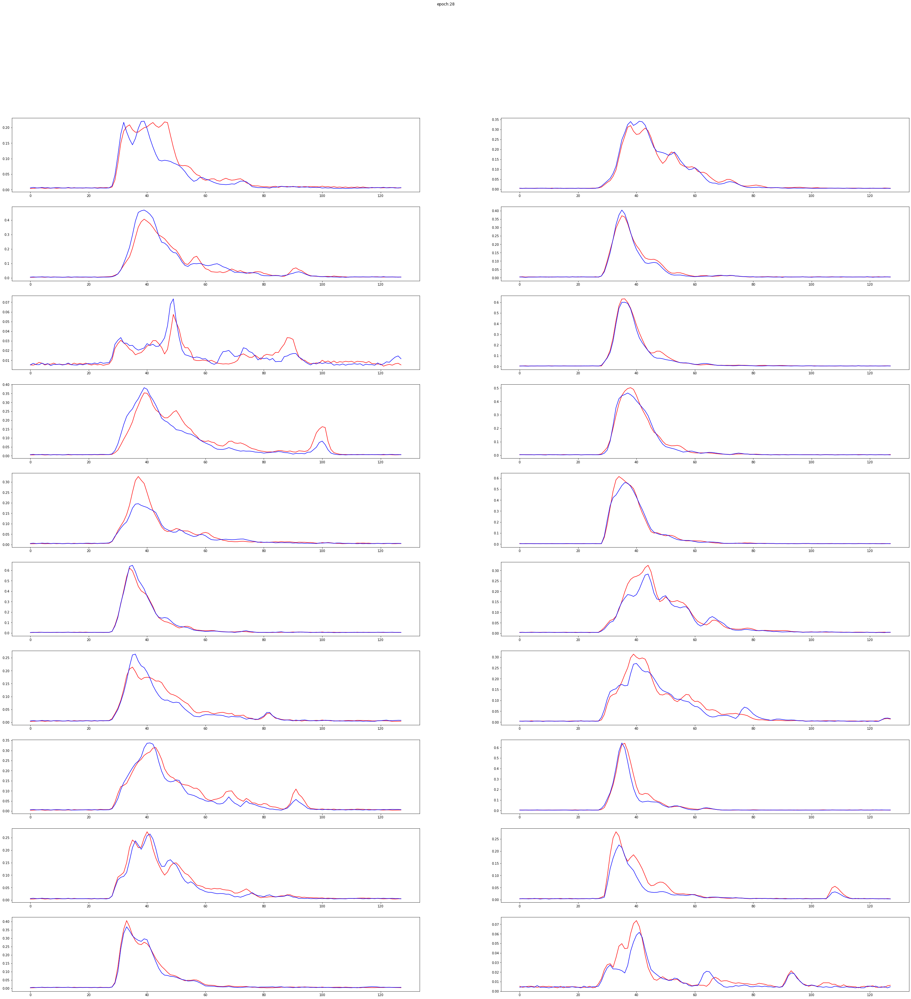

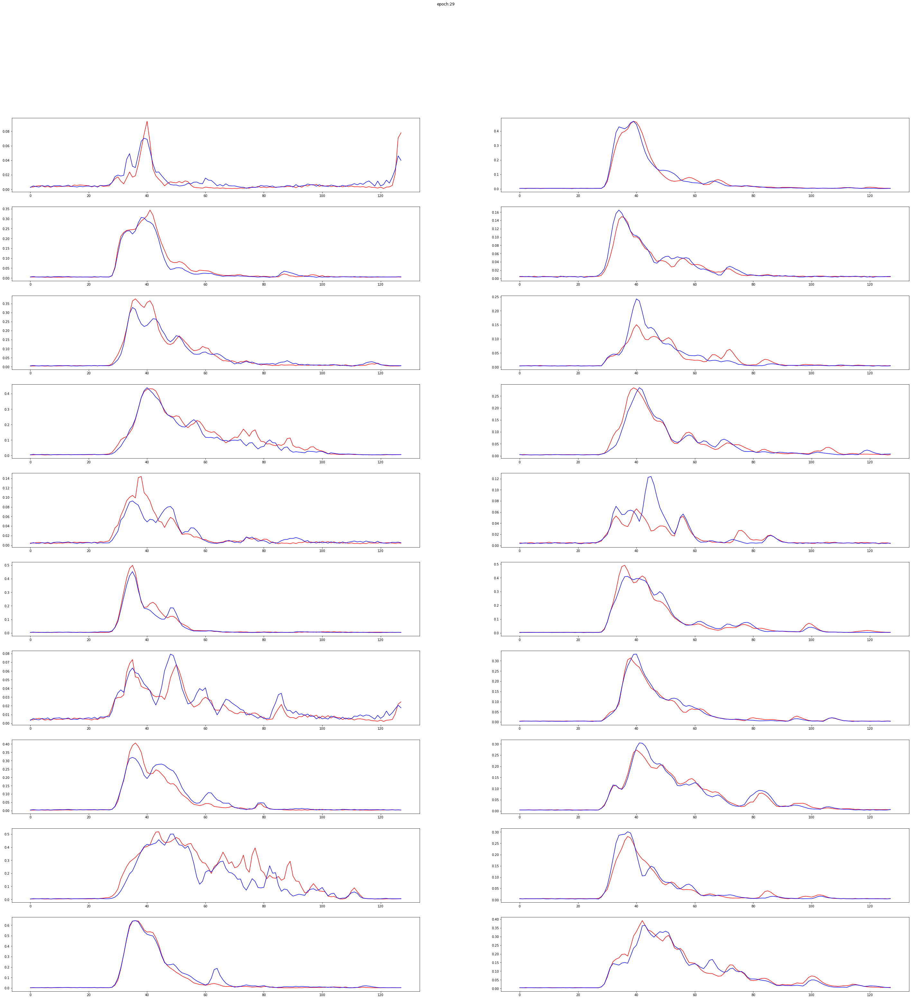

In [90]:
# os.mkdir('seccessful_models')
for i in range(len(seccessful_models)):
    # load model and noise_dim
    dir_name=os.path.join('seccessfuk_models',os.path.basename(seccessful_models[i]))
    if not(os.path.exists(dir_name)):
        os.mkdir(dir_name)
        os.mkdir('{}/save_images'.format(dir_name))
        os.mkdir('{}/save_model'.format(dir_name))
    gen_n=f'{seccessful_models[i]}/save_model/generator/ep0'
    generator=tf.keras.models.load_model(gen_n)
    disc_n=f'{seccessful_models[i]}/save_model/discriminator/ep0'
    discriminator=tf.keras.models.load_model(disc_n)
    noise_dim=noise_dict[seccessful_models[i]]
#     print(noise_dim)
    shape=(128,2)
    # generator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.00001, beta_1=0, beta_2=0.9)
    generator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0001, beta_1=0, beta_2=0.9)
    discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0001, beta_1=0, beta_2=0.9)
    loss_function = tf.keras.losses.BinaryCrossentropy(from_logits=True)
    scal_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0001, beta_1=0, beta_2=0.9)
    
    
    
    
    # reinitilisation function (rewrite this bag)
    def discriminator_loss(real_output, fake_output):
    #     real_loss = loss_function(tf.ones_like(real_output), real_output)
    #     fake_loss = loss_function(tf.zeros_like(fake_output), fake_output)
        real_loss = -tf.reduce_mean(real_output)
        fake_loss = tf.reduce_mean(fake_output)
        total_loss = real_loss + fake_loss
        return total_loss

    def generator_loss(fake_output):
    #     return loss_function(tf.ones_like(fake_output), fake_output)
        return -tf.reduce_mean(fake_output)

    def gradient_penalti(batch,real_data,fake_data):
    #   alpha = tf.random.normal([batch, 1], 0.0, 1.0)
    #   diff = fake_data - real_data
    #   interpolated = real_data + alpha * diff
        epsilon=tf.random.uniform(shape=(batch,1,1),dtype=tf.dtypes.float32)
        interpolated=real_data-epsilon*(real_data-fake_data)# вычисление x^ как в статье
        with tf.GradientTape() as gp_tape:
            gp_tape.watch(interpolated)
            pred=discriminator(interpolated,training=True)  # D(x^)
        grads = gp_tape.gradient(pred, [interpolated])[0]# because list
        norm = tf.sqrt(tf.reduce_sum(tf.square(grads), axis=[1]))
        gp = tf.reduce_mean((norm - 1.0) ** 2)
        return gp    
    @tf.function
    def train_step_WGAN(labda,batch,real_data,weight_gp,weight_corr):
      # labda --> number learling critic
      #weight --> weight gradient_penalti

      #learning critic
        for i in range(labda):
            with tf.GradientTape() as gr:
                noise = tf.random.normal(shape=(batch,noise_dim))
                fake_data=generator(noise)#change
    #             print('f')
                real_data=real_data
                fake_predict=discriminator(fake_data)
                real_predict=discriminator(real_data)
                real_data=tf.cast(real_data,dtype=tf.float32)
                gp=gradient_penalti(batch,real_data,fake_data)
                disc_loss=discriminator_loss(real_predict,fake_predict)+weight_gp*gp # critic loss include GP
            d_grad=gr.gradient(disc_loss, discriminator.trainable_variables)
            discriminator_optimizer.apply_gradients(zip(d_grad, discriminator.trainable_variables))


      #learning generator
        noise = tf.random.normal(shape=(batch,noise_dim))
        with tf.GradientTape() as gr:
            fake_data=generator(noise)
            fake_predict=discriminator(fake_data)
    #         corr_loss=correletion_loss(fake_data)
            gen_loss=generator_loss(fake_predict)# +weight_corr*corr_loss




        g_grad=gr.gradient(gen_loss,generator.trainable_variables)
        generator_optimizer.apply_gradients(zip(g_grad, generator.trainable_variables))
        return (gen_loss,disc_loss)

    def image(n,num=10):
        fig, axes =plt.subplots(num,2,figsize=(50,50))


        for i in range(num):
            noise = tf.random.normal(shape=(1,noise_dim))
            axes[i,0].plot((generator(noise))[0,:,1],'r')#change
            axes[i,0].plot((generator(noise))[0,:,0],'b')
            j=random.randint(0,len(train))
            axes[i,1].plot(train[j,:,1],'r')
            axes[i,1].plot(train[j,:,0],'b')
            plt.suptitle("epoch:"+str(n))
            plt.savefig("{}/save_images/epoch{}.png".format(dir_name,n))

    
    
    
    batch=64
    epochs=30
    ep_start=0
    g_list=[]
    d_list=[]
    def train_WGAN(epochs,train_data,batch):
        plt.figure()
        for j in tqdm_notebook(range(ep_start,epochs),seccessful_models[i]):
            for num in range (0,len(train_data),batch):
                step_data=train_data[num:num+batch]
                g,d=train_step_WGAN(labda=5,batch=batch,real_data=step_data,weight_gp=10,weight_corr=1)
                d_list.append(d)
                g_list.append(g)
    #             disc_loss_list.append(disc_loss)
    #             gen_loss_list.append(gen_loss)
                #corr_loss_list1.append(corr_loss)
    #         generator.save("del")
#             if (j % 10 == 0):
            image(j)
            discriminator.save("{}/save_model/discriminator/ep{}".format(dir_name,j))
            generator.save("{}/save_model/generator/ep{}".format(dir_name,j))
    train_WGAN(epochs,train,batch)


In [105]:
seccessful_models=['with_CONV2_real','with_noise_198']
def Residual_loss(data_true, data_fake):
    return tf.reduce_mean( tf.math.abs(data_true - data_fake),axis=(1,2))
def Discriminator_loss(data_true, data_fake,discriminator):
    real_pred=discriminator(data_true)
    fake_pred=discriminator(data_fake)
    return tf.math.abs( real_pred - fake_pred)
loss_L=[]
def find_noise(generator,discriminator,image,noise_dim,alpha=1.2,k_rd=0.0001):
#         global loss_L
#     print(image.sha)
    global loss_L
    loss_befor=1000000000
    k=0
    noise = tf.random.normal(shape=(image.shape[0],noise_dim))
    noise_befor=tf.identity(noise)
    for i in tqdm.tqdm(range(3000)):
        with tf.GradientTape() as tape:
            tape.watch(noise)
            fake=generator(noise)
            loss=Residual_loss(image, fake)
            loss_disc=Discriminator_loss(image, fake,discriminator)*k_rd
            Loss=tf.reshape(loss,(-1,1))+loss_disc
            loss_L.append(Loss)
        g_grad=tape.gradient(Loss,noise)
        noise=noise-alpha*g_grad
        if tf.math.reduce_mean((loss_befor-Loss))<0.005*tf.math.reduce_mean(Loss):
            k+=1
            if k>7:
                break
        else:
            loss_befor=Loss
            k=0
            
    return (noise,noise_befor)
def func_chunks_generators(lst, n):
        '''передается масив и число.масив разбивается на масивы длиной не более n
        пример func_chunks_generators([1,2,3,4,5], 3) -> [[1,2,3],[4,5]]
        lst- масив
        n- число, пределяющее максимальную длину'''
        l=[]
        for i in range(0, len(lst), n):
             l.append(lst[i : i + n])
        return(l)
def metric(generator,discriminator,data,noise_dim,batch=64,k_rd=0.0001,name='???'):
    m=np.array([])
    data_list=func_chunks_generators(data,batch)
    for image in tqdm_notebook(data_list,name):
#         print(np.array(image).shape)
        image=np.reshape(np.array(image),(-1,128,2))
        image=np.array(image)
        noise_after,noise_befor=find_noise(generator,discriminator,image,noise_dim=noise_dim)
        fake=generator(noise_after)
        L_R=Residual_loss(image,fake)
        L_D=Discriminator_loss(image, fake,discriminator)*k_rd
        loss=L_R+L_D
        m=np.append(m,loss)
    return m.mean()

# epochs=np.array([1,5,10,15,20,30],dtype=int)-1
# df=pd.DataFrame(index=epochs,columns=seccessful_models)
# for i in tqdm_notebook(range(len(seccessful_models)),'all'):
#     noise_dim=noise_dict[seccessful_models[i]]
#     for ep in tqdm_notebook(epochs,seccessful_models[i]):
#         dir_name=os.path.join('seccessfuk_models',os.path.basename(seccessful_models[i]))
#         gen_n=f'{dir_name}/save_model/generator/ep{ep}'
#         generator=tf.keras.models.load_model(gen_n)
#         disc_n=f'{dir_name}/save_model/discriminator/ep{ep}'
#         discriminator=tf.keras.models.load_model(disc_n)
#         met=metric(generator,discriminator,train[:5000],noise_dim,batch=64,k_rd=0.0001,name=os.path.basename(seccessful_models[i])+'   ' + str(ep))
#         df[seccessful_models[i]][ep]=met
#         print(met)
    
    
# df.to_csv('seccessfuk_models/metrics_2.csv') 

In [162]:
dir_name=os.path.join('seccessfuk_models',"with_noise_198")
gen_n=f'{dir_name}/save_model/generator/ep{ep}'
generator=tf.keras.models.load_model(gen_n)
disc_n=f'{dir_name}/save_model/discriminator/ep{ep}'
discriminator=tf.keras.models.load_model(disc_n)
met=metric(generator,discriminator,train[:64],noise_dim,batch=64,k_rd=0.0001,name=os.path.basename(seccessful_models[i])+'   ' + str(ep))

 15%|█▍        | 444/3000 [00:15<01:29, 28.46it/s]

438


 15%|█▌        | 453/3000 [00:16<01:29, 28.43it/s]

447


 15%|█▌        | 462/3000 [00:16<01:29, 28.47it/s]

456


 16%|█▌        | 471/3000 [00:16<01:29, 28.40it/s]

465


 16%|█▌        | 480/3000 [00:17<01:28, 28.45it/s]

474


 16%|█▋        | 489/3000 [00:17<01:28, 28.43it/s]

483
484


 17%|█▋        | 498/3000 [00:17<01:28, 28.38it/s]

493
494


 17%|█▋        | 507/3000 [00:17<01:27, 28.37it/s]

503
504


 17%|█▋        | 519/3000 [00:18<01:27, 28.42it/s]

513
514


 18%|█▊        | 528/3000 [00:18<01:27, 28.39it/s]

523
524
525


 18%|█▊        | 540/3000 [00:19<01:26, 28.44it/s]

534
535
536


 18%|█▊        | 549/3000 [00:19<01:26, 28.40it/s]

545
546
547


 19%|█▊        | 561/3000 [00:19<01:25, 28.46it/s]

556
557
558


 19%|█▉        | 573/3000 [00:20<01:27, 27.83it/s]

567
568
569


 19%|█▉        | 582/3000 [00:20<01:25, 28.21it/s]

578
579
580


 20%|█▉        | 594/3000 [00:21<01:24, 28.32it/s]

589
590
591
592


 20%|██        | 606/3000 [00:21<01:24, 28.36it/s]

601
602
603
604


 21%|██        | 618/3000 [00:21<01:23, 28.37it/s]

613
614
615
616


 21%|██        | 630/3000 [00:22<01:23, 28.37it/s]

625
626
627
628


 21%|██▏       | 642/3000 [00:22<01:23, 28.37it/s]

637
638
639
640


 22%|██▏       | 654/3000 [00:23<01:22, 28.36it/s]

649
650
651
652
653


 22%|██▏       | 666/3000 [00:23<01:22, 28.38it/s]

662
663
664
665
666


 23%|██▎       | 681/3000 [00:24<01:21, 28.32it/s]

675
676
677
678
679


 23%|██▎       | 693/3000 [00:24<01:21, 28.38it/s]

688
689
690
691
692


 24%|██▎       | 705/3000 [00:24<01:22, 27.91it/s]

701
702
703
704
705


 24%|██▍       | 720/3000 [00:25<01:22, 27.74it/s]

714
715
716
717
718


 24%|██▍       | 732/3000 [00:25<01:20, 28.20it/s]

727
728
729
730
731


 25%|██▍       | 744/3000 [00:26<01:19, 28.27it/s]

740
741
742
743
744


 25%|██▌       | 759/3000 [00:26<01:19, 28.33it/s]

753
754
755
756
757
758


 26%|██▌       | 771/3000 [00:27<01:18, 28.37it/s]

767
768
769
770
771
772


 26%|██▌       | 786/3000 [00:27<01:17, 28.40it/s]

781
782
783
784
785
786


 27%|██▋       | 801/3000 [00:28<01:17, 28.37it/s]

795
796
797
798
799
800


 27%|██▋       | 813/3000 [00:28<01:16, 28.40it/s]

809
810
811
812
813
814


 28%|██▊       | 828/3000 [00:29<01:16, 28.32it/s]

823
824
825
826
827
828


 28%|██▊       | 843/3000 [00:29<01:16, 28.29it/s]

837
838
839
840
841
842


 28%|██▊       | 855/3000 [00:30<01:15, 28.37it/s]

851
852
853
854
855
856


 29%|██▊       | 861/3000 [00:30<01:15, 28.34it/s]

857


 29%|██▉       | 870/3000 [00:30<01:15, 28.34it/s]

866
867
868
869
870
871


 30%|██▉       | 885/3000 [00:31<01:14, 28.35it/s]

880
881
882
883
884
885


 30%|███       | 900/3000 [00:31<01:14, 28.36it/s]

894
895
896
897
898
899


 30%|███       | 906/3000 [00:32<01:13, 28.39it/s]

900


 30%|███       | 915/3000 [00:32<01:13, 28.30it/s]

909
910
911
912
913
914


 31%|███       | 921/3000 [00:32<01:13, 28.38it/s]

915


 31%|███       | 930/3000 [00:32<01:13, 28.33it/s]

924
925
926
927
928
929


 31%|███       | 936/3000 [00:33<01:12, 28.35it/s]

930


 32%|███▏      | 945/3000 [00:33<01:12, 28.37it/s]

939
940
941
942
943
944


 32%|███▏      | 951/3000 [00:33<01:12, 28.40it/s]

945


 32%|███▏      | 960/3000 [00:33<01:11, 28.35it/s]

954
955
956
957
958
959


 32%|███▏      | 966/3000 [00:34<01:11, 28.36it/s]

960


 32%|███▎      | 975/3000 [00:34<01:11, 28.25it/s]

969
970
971
972
973
974


 33%|███▎      | 981/3000 [00:34<01:11, 28.31it/s]

975
976


 33%|███▎      | 990/3000 [00:35<01:11, 27.99it/s]

985
986
987
988
989
990


 33%|███▎      | 996/3000 [00:35<01:11, 28.08it/s]

991


 34%|███▎      | 1005/3000 [00:35<01:10, 28.19it/s]

1000
1001
1002
1003
1004
1005


 34%|███▎      | 1011/3000 [00:35<01:10, 28.18it/s]

1006


 34%|███▍      | 1020/3000 [00:36<01:10, 28.27it/s]

1015
1016
1017
1018
1019
1020


 34%|███▍      | 1026/3000 [00:36<01:09, 28.32it/s]

1021
1022


 34%|███▍      | 1035/3000 [00:36<01:09, 28.34it/s]

1031
1032
1033
1034
1035
1036


 35%|███▍      | 1041/3000 [00:36<01:11, 27.31it/s]

1037


 35%|███▌      | 1050/3000 [00:37<01:10, 27.81it/s]

1046
1047
1048
1049
1050
1051


 35%|███▌      | 1056/3000 [00:37<01:09, 27.84it/s]

1052
1053


 36%|███▌      | 1068/3000 [00:37<01:08, 28.07it/s]

1062
1063
1064
1065
1066
1067


 36%|███▌      | 1074/3000 [00:38<01:08, 28.05it/s]

1068
1069


 36%|███▌      | 1083/3000 [00:38<01:09, 27.66it/s]

1078
1079
1080
1081
1082
1083


 36%|███▋      | 1089/3000 [00:38<01:08, 27.87it/s]

1084


 37%|███▋      | 1098/3000 [00:38<01:07, 28.03it/s]

1093
1094
1095
1096
1097
1098


 37%|███▋      | 1104/3000 [00:39<01:07, 27.93it/s]

1099


 37%|███▋      | 1113/3000 [00:39<01:07, 28.08it/s]

1108
1109
1110
1111
1112
1113


 37%|███▋      | 1119/3000 [00:39<01:07, 28.03it/s]

1114


 38%|███▊      | 1128/3000 [00:39<01:06, 28.05it/s]

1123
1124
1125
1126
1127
1128


 38%|███▊      | 1134/3000 [00:40<01:06, 28.08it/s]

1129
1130


 38%|███▊      | 1143/3000 [00:40<01:05, 28.17it/s]

1139
1140
1141
1142
1143
1144


 38%|███▊      | 1149/3000 [00:40<01:05, 28.13it/s]

1145
1146


 39%|███▊      | 1161/3000 [00:41<01:05, 28.08it/s]

1155
1156
1157
1158
1159
1160


 39%|███▉      | 1167/3000 [00:41<01:05, 28.11it/s]

1161
1162


 39%|███▉      | 1176/3000 [00:41<01:05, 28.05it/s]

1171
1172
1173
1174
1175
1176


 39%|███▉      | 1182/3000 [00:41<01:04, 28.05it/s]

1177
1178


 40%|███▉      | 1191/3000 [00:42<01:05, 27.43it/s]

1187
1188
1189
1190
1191
1192


 40%|███▉      | 1197/3000 [00:42<01:05, 27.67it/s]

1193
1194
1195


 40%|████      | 1209/3000 [00:42<01:03, 28.05it/s]

1204
1205
1206
1207
1208
1209


 40%|████      | 1215/3000 [00:43<01:03, 28.05it/s]

1210
1211
1212


 41%|████      | 1227/3000 [00:43<01:03, 28.12it/s]

1221
1222
1223
1224
1225
1226


 41%|████      | 1233/3000 [00:43<01:02, 28.12it/s]

1227
1228
1229


 41%|████▏     | 1242/3000 [00:44<01:02, 28.15it/s]

1238
1239
1240
1241
1242
1243


 42%|████▏     | 1248/3000 [00:44<01:02, 28.10it/s]

1244
1245
1246


 42%|████▏     | 1260/3000 [00:44<01:01, 28.17it/s]

1255
1256
1257
1258
1259
1260


 42%|████▏     | 1266/3000 [00:44<01:01, 28.03it/s]

1261
1262
1263
1264


 43%|████▎     | 1278/3000 [00:45<01:01, 28.07it/s]

1273
1274
1275
1276
1277
1278


 43%|████▎     | 1284/3000 [00:45<01:01, 28.05it/s]

1279
1280
1281
1282


 43%|████▎     | 1296/3000 [00:45<01:00, 28.01it/s]

1291
1292
1293
1294
1295
1296


 43%|████▎     | 1302/3000 [00:46<01:00, 28.00it/s]

1297
1298
1299
1300


 44%|████▍     | 1314/3000 [00:46<00:59, 28.13it/s]

1309
1310
1311
1312
1313
1314


 44%|████▍     | 1320/3000 [00:46<01:00, 27.65it/s]

1315
1316
1317
1318
1319


 44%|████▍     | 1332/3000 [00:47<00:59, 28.09it/s]

1328
1329
1330
1331
1332
1333


 45%|████▍     | 1338/3000 [00:47<00:59, 28.05it/s]

1334
1335
1336


 45%|████▌     | 1350/3000 [00:47<01:00, 27.50it/s]

1345
1346
1347
1348
1349
1350


 45%|████▌     | 1356/3000 [00:48<00:59, 27.76it/s]

1351
1352
1353
1354
1355


 46%|████▌     | 1368/3000 [00:48<00:57, 28.14it/s]

1364
1365
1366
1367
1368
1369


 46%|████▌     | 1374/3000 [00:48<00:57, 28.14it/s]

1370
1371
1372
1373
1374


 46%|████▋     | 1389/3000 [00:49<00:56, 28.27it/s]

1383
1384
1385
1386
1387
1388


 46%|████▋     | 1395/3000 [00:49<00:59, 27.12it/s]

1389
1390
1391
1392
1393
1394


 47%|████▋     | 1407/3000 [00:49<00:56, 27.99it/s]

1403
1404
1405
1406
1407
1408


 47%|████▋     | 1413/3000 [00:50<00:56, 27.99it/s]

1409
1410
1411
1412
1413


 48%|████▊     | 1428/3000 [00:50<00:56, 27.94it/s]

1422
1423
1424
1425
1426
1427


 48%|████▊     | 1434/3000 [00:50<00:55, 28.00it/s]

1428
1429
1430
1431
1432
1433


 48%|████▊     | 1446/3000 [00:51<00:55, 28.17it/s]

1442
1443
1444
1445
1446
1447


 48%|████▊     | 1452/3000 [00:51<00:55, 28.13it/s]

1448
1449
1450
1451
1452
1453


 49%|████▉     | 1467/3000 [00:52<00:54, 28.17it/s]

1462
1463
1464
1465
1466
1467


 49%|████▉     | 1473/3000 [00:52<00:54, 28.14it/s]

1468
1469
1470
1471
1472
1473


 49%|████▉     | 1479/3000 [00:52<00:53, 28.22it/s]

1474


 50%|████▉     | 1488/3000 [00:52<00:53, 28.28it/s]

1483
1484
1485
1486
1487
1488


 50%|████▉     | 1494/3000 [00:53<00:53, 28.19it/s]

1489
1490
1491
1492
1493
1494


 50%|█████     | 1500/3000 [00:53<00:53, 27.85it/s]

1495


 50%|█████     | 1515/3000 [00:53<00:52, 28.05it/s]

1510
1511
1512
1513
1514
1515


 51%|█████     | 1521/3000 [00:54<00:52, 28.12it/s]

1516
1517


 51%|█████     | 1530/3000 [00:54<00:52, 28.21it/s]

1526
1527
1528
1529
1530
1531


 51%|█████     | 1536/3000 [00:54<00:52, 28.09it/s]

1532
1533
1534
1535
1536
1537


 51%|█████▏    | 1542/3000 [00:54<00:51, 28.17it/s]

1538


 52%|█████▏    | 1551/3000 [00:55<00:51, 28.19it/s]

1547
1548
1549
1550
1551
1552


 52%|█████▏    | 1557/3000 [00:55<00:51, 28.13it/s]

1553
1554
1555
1556
1557
1558


 52%|█████▏    | 1563/3000 [00:55<00:51, 28.16it/s]

1559


 52%|█████▏    | 1572/3000 [00:55<00:50, 28.25it/s]

1568
1569
1570
1571
1572
1573


 53%|█████▎    | 1578/3000 [00:56<00:50, 28.25it/s]

1574
1575
1576
1577
1578
1579


 53%|█████▎    | 1584/3000 [00:56<00:51, 27.62it/s]

1580


 53%|█████▎    | 1593/3000 [00:56<00:50, 28.08it/s]

1589
1590
1591
1592
1593
1594


 53%|█████▎    | 1599/3000 [00:56<00:49, 28.06it/s]

1595
1596
1597
1598
1599
1600


 54%|█████▎    | 1605/3000 [00:57<00:49, 28.10it/s]

1601
1602
1603


 54%|█████▍    | 1617/3000 [00:57<00:49, 28.22it/s]

1612
1613
1614
1615
1616
1617


 54%|█████▍    | 1623/3000 [00:57<00:48, 28.18it/s]

1618
1619
1620
1621
1622
1623


 54%|█████▍    | 1629/3000 [00:57<00:49, 27.47it/s]

1624
1625
1626


 55%|█████▍    | 1641/3000 [00:58<00:48, 27.87it/s]

1635
1636
1637
1638
1639
1640


 55%|█████▍    | 1647/3000 [00:58<00:48, 28.03it/s]

1641
1642
1643
1644
1645
1646


 55%|█████▌    | 1653/3000 [00:58<00:47, 28.15it/s]

1647
1648
1649


 55%|█████▌    | 1662/3000 [00:59<00:47, 28.25it/s]

1658
1659
1660
1661
1662
1663


 56%|█████▌    | 1668/3000 [00:59<00:47, 28.22it/s]

1664
1665
1666
1667
1668
1669


 56%|█████▌    | 1674/3000 [00:59<00:47, 28.14it/s]

1670
1671
1672


 56%|█████▌    | 1686/3000 [00:59<00:46, 28.18it/s]

1681
1682
1683
1684
1685
1686


 56%|█████▋    | 1692/3000 [01:00<00:46, 28.12it/s]

1687
1688
1689
1690
1691
1692


 57%|█████▋    | 1698/3000 [01:00<00:46, 28.04it/s]

1693
1694
1695
1696


 57%|█████▋    | 1710/3000 [01:00<00:45, 28.19it/s]

1705
1706
1707
1708
1709
1710


 57%|█████▋    | 1716/3000 [01:00<00:45, 28.10it/s]

1711
1712
1713
1714
1715
1716


 57%|█████▋    | 1722/3000 [01:01<00:47, 27.14it/s]

1717
1718


 58%|█████▊    | 1731/3000 [01:01<00:45, 27.90it/s]

1727
1728
1729
1730
1731
1732


 58%|█████▊    | 1737/3000 [01:01<00:45, 28.02it/s]

1733
1734
1735
1736
1737
1738


 58%|█████▊    | 1743/3000 [01:01<00:44, 28.05it/s]

1739
1740
1741


 58%|█████▊    | 1755/3000 [01:02<00:44, 28.22it/s]

1750
1751
1752
1753
1754
1755


 59%|█████▊    | 1761/3000 [01:02<00:44, 28.14it/s]

1756
1757
1758
1759
1760
1761


 59%|█████▉    | 1767/3000 [01:02<00:43, 28.11it/s]

1762
1763
1764
1765


 59%|█████▉    | 1779/3000 [01:03<00:43, 28.22it/s]

1774
1775
1776
1777
1778
1779


 60%|█████▉    | 1785/3000 [01:03<00:43, 28.16it/s]

1780
1781
1782
1783
1784
1785


 60%|█████▉    | 1791/3000 [01:03<00:42, 28.17it/s]

1786
1787
1788
1789


 60%|██████    | 1803/3000 [01:04<00:42, 28.27it/s]

1798
1799
1800
1801
1802
1803


 60%|██████    | 1809/3000 [01:04<00:42, 28.18it/s]

1804
1805
1806
1807
1808
1809


 60%|██████    | 1815/3000 [01:04<00:42, 27.69it/s]

1810
1811
1812


 61%|██████    | 1827/3000 [01:04<00:41, 28.11it/s]

1821
1822
1823
1824
1825
1826


 61%|██████    | 1833/3000 [01:05<00:41, 28.06it/s]

1827
1828
1829
1830
1831
1832


 61%|██████▏   | 1839/3000 [01:05<00:41, 28.09it/s]

1833
1834
1835
1836
1837


 62%|██████▏   | 1851/3000 [01:05<00:40, 28.27it/s]

1846
1847
1848
1849
1850
1851


 62%|██████▏   | 1857/3000 [01:05<00:40, 28.18it/s]

1852
1853
1854
1855
1856
1857


 62%|██████▏   | 1863/3000 [01:06<00:40, 28.10it/s]

1858
1859
1860
1861


 62%|██████▎   | 1875/3000 [01:06<00:39, 28.25it/s]

1870
1871
1872
1873
1874
1875


 63%|██████▎   | 1881/3000 [01:06<00:40, 27.64it/s]

1876
1877
1878
1879
1880
1881


 63%|██████▎   | 1887/3000 [01:07<00:40, 27.82it/s]

1882
1883
1884
1885
1886
1887


 63%|██████▎   | 1902/3000 [01:07<00:38, 28.24it/s]

1896
1897
1898
1899
1900
1901


 64%|██████▎   | 1908/3000 [01:07<00:38, 28.21it/s]

1902
1903
1904
1905
1906
1907


 64%|██████▍   | 1914/3000 [01:08<00:38, 28.14it/s]

1908
1909
1910
1911
1912


 64%|██████▍   | 1926/3000 [01:08<00:38, 28.22it/s]

1921
1922
1923
1924
1925
1926


 64%|██████▍   | 1932/3000 [01:08<00:37, 28.13it/s]

1927
1928
1929
1930
1931
1932


 65%|██████▍   | 1938/3000 [01:08<00:37, 28.12it/s]

1933
1934
1935
1936
1937


 65%|██████▌   | 1950/3000 [01:09<00:37, 28.09it/s]

1946
1947
1948
1949
1950
1951


 65%|██████▌   | 1956/3000 [01:09<00:37, 28.09it/s]

1952
1953
1954
1955
1956
1957


 65%|██████▌   | 1962/3000 [01:09<00:36, 28.12it/s]

1958
1959
1960
1961
1962
1963


 66%|██████▌   | 1977/3000 [01:10<00:36, 27.65it/s]

1972
1973
1974
1975
1976
1977


 66%|██████▌   | 1983/3000 [01:10<00:37, 27.44it/s]

1978
1979
1980
1981
1982
1983


 66%|██████▋   | 1989/3000 [01:10<00:36, 27.80it/s]

1984
1985
1986
1987
1988
1989


 67%|██████▋   | 2004/3000 [01:11<00:35, 28.09it/s]

1998
1999
2000
2001
2002
2003


 67%|██████▋   | 2010/3000 [01:11<00:35, 27.60it/s]

2004
2005
2006
2007
2008
2009


 67%|██████▋   | 2016/3000 [01:11<00:35, 27.84it/s]

2010
2011
2012
2013
2014


 68%|██████▊   | 2028/3000 [01:12<00:34, 28.10it/s]

2023
2024
2025
2026
2027
2028


 68%|██████▊   | 2034/3000 [01:12<00:34, 28.13it/s]

2029
2030
2031
2032
2033
2034


 68%|██████▊   | 2040/3000 [01:12<00:34, 28.12it/s]

2035
2036
2037
2038
2039


 68%|██████▊   | 2052/3000 [01:12<00:33, 28.23it/s]

2048
2049
2050
2051
2052
2053


 69%|██████▊   | 2058/3000 [01:13<00:33, 28.14it/s]

2054
2055
2056
2057
2058
2059


 69%|██████▉   | 2064/3000 [01:13<00:33, 28.18it/s]

2060
2061
2062
2063
2064


 69%|██████▉   | 2079/3000 [01:13<00:33, 27.87it/s]

2073
2074
2075
2076
2077
2078


 70%|██████▉   | 2085/3000 [01:14<00:32, 27.99it/s]

2079
2080
2081
2082
2083
2084


 70%|██████▉   | 2091/3000 [01:14<00:32, 28.05it/s]

2085
2086
2087
2088
2089
2090


 70%|███████   | 2103/3000 [01:14<00:32, 27.40it/s]

2099
2100
2101
2102
2103
2104


 70%|███████   | 2109/3000 [01:14<00:32, 27.73it/s]

2105
2106
2107
2108
2109
2110


 70%|███████   | 2115/3000 [01:15<00:31, 27.82it/s]

2111
2112
2113
2114
2115
2116


 71%|███████   | 2130/3000 [01:15<00:30, 28.14it/s]

2125
2126
2127
2128
2129
2130


 71%|███████   | 2136/3000 [01:15<00:30, 28.09it/s]

2131
2132
2133
2134
2135
2136


 71%|███████▏  | 2142/3000 [01:16<00:30, 28.10it/s]

2137
2138
2139
2140
2141
2142


 72%|███████▏  | 2157/3000 [01:16<00:29, 28.20it/s]

2151
2152
2153
2154
2155
2156


 72%|███████▏  | 2163/3000 [01:16<00:29, 28.21it/s]

2157
2158
2159
2160
2161
2162


 72%|███████▏  | 2169/3000 [01:17<00:29, 28.09it/s]

2163
2164
2165
2166
2167
2168


 73%|███████▎  | 2181/3000 [01:17<00:29, 28.00it/s]

2177
2178
2179
2180
2181
2182


 73%|███████▎  | 2187/3000 [01:17<00:29, 28.03it/s]

2183
2184
2185
2186
2187
2188


 73%|███████▎  | 2193/3000 [01:17<00:28, 28.07it/s]

2189
2190
2191
2192
2193
2194


 73%|███████▎  | 2199/3000 [01:18<00:28, 28.14it/s]

2195


 74%|███████▎  | 2208/3000 [01:18<00:28, 28.22it/s]

2204
2205
2206
2207
2208
2209


 74%|███████▍  | 2214/3000 [01:18<00:27, 28.17it/s]

2210
2211
2212
2213
2214
2215


 74%|███████▍  | 2220/3000 [01:18<00:27, 28.10it/s]

2216
2217
2218
2219
2220
2221


 74%|███████▍  | 2235/3000 [01:19<00:27, 28.30it/s]

2230
2231
2232
2233
2234
2235


 75%|███████▍  | 2241/3000 [01:19<00:26, 28.15it/s]

2236
2237
2238
2239
2240
2241


 75%|███████▍  | 2247/3000 [01:19<00:26, 28.20it/s]

2242
2243
2244
2245
2246
2247


 75%|███████▌  | 2253/3000 [01:20<00:26, 28.14it/s]

2248
2249


 75%|███████▌  | 2262/3000 [01:20<00:26, 28.15it/s]

2258
2259
2260
2261
2262
2263


 76%|███████▌  | 2268/3000 [01:20<00:26, 28.09it/s]

2264
2265
2266
2267
2268
2269


 76%|███████▌  | 2274/3000 [01:20<00:25, 28.11it/s]

2270
2271
2272
2273
2274
2275


 76%|███████▌  | 2280/3000 [01:21<00:25, 28.14it/s]

2276
2277


 76%|███████▋  | 2292/3000 [01:21<00:25, 28.20it/s]

2286
2287
2288
2289
2290
2291


 77%|███████▋  | 2298/3000 [01:21<00:24, 28.15it/s]

2292
2293
2294
2295
2296
2297


 77%|███████▋  | 2304/3000 [01:21<00:24, 28.10it/s]

2298
2299
2300
2301
2302
2303


 77%|███████▋  | 2310/3000 [01:22<00:24, 28.06it/s]

2304
2305
2306


 77%|███████▋  | 2319/3000 [01:22<00:24, 27.56it/s]

2315
2316
2317
2318
2319
2320


 78%|███████▊  | 2325/3000 [01:22<00:24, 27.79it/s]

2321
2322
2323
2324
2325
2326


 78%|███████▊  | 2331/3000 [01:22<00:23, 27.93it/s]

2327
2328
2329
2330
2331
2332


 78%|███████▊  | 2337/3000 [01:23<00:23, 28.01it/s]

2333
2334


 78%|███████▊  | 2349/3000 [01:23<00:23, 28.19it/s]

2343
2344
2345
2346
2347
2348


 78%|███████▊  | 2355/3000 [01:23<00:22, 28.07it/s]

2349
2350
2351
2352
2353
2354


 79%|███████▊  | 2361/3000 [01:23<00:22, 28.04it/s]

2355
2356
2357
2358
2359
2360


 79%|███████▉  | 2367/3000 [01:24<00:22, 28.10it/s]

2361
2362


 79%|███████▉  | 2376/3000 [01:24<00:22, 28.17it/s]

2371
2372
2373
2374
2375
2376


 79%|███████▉  | 2382/3000 [01:24<00:21, 28.17it/s]

2377
2378
2379
2380
2381
2382


 80%|███████▉  | 2388/3000 [01:24<00:21, 28.08it/s]

2383
2384
2385
2386
2387
2388


 80%|███████▉  | 2394/3000 [01:25<00:21, 28.18it/s]

2389
2390
2391


 80%|████████  | 2406/3000 [01:25<00:21, 28.17it/s]

2400
2401
2402
2403
2404
2405


 80%|████████  | 2412/3000 [01:25<00:20, 28.12it/s]

2406
2407
2408
2409
2410
2411


 81%|████████  | 2418/3000 [01:25<00:20, 28.11it/s]

2412
2413
2414
2415
2416
2417


 81%|████████  | 2424/3000 [01:26<00:20, 28.22it/s]

2418


 81%|████████  | 2433/3000 [01:26<00:20, 27.80it/s]

2427
2428
2429
2430
2431
2432


 81%|████████▏ | 2439/3000 [01:26<00:20, 27.96it/s]

2433
2434
2435
2436
2437
2438


 82%|████████▏ | 2445/3000 [01:26<00:19, 28.04it/s]

2439
2440
2441
2442
2443
2444


 82%|████████▏ | 2451/3000 [01:27<00:19, 28.07it/s]

2445
2446
2447
2448


 82%|████████▏ | 2463/3000 [01:27<00:19, 27.67it/s]

2457
2458
2459
2460
2461
2462


 82%|████████▏ | 2469/3000 [01:27<00:19, 27.93it/s]

2463
2464
2465
2466
2467
2468


 82%|████████▎ | 2475/3000 [01:28<00:18, 28.02it/s]

2469
2470
2471
2472
2473
2474


 83%|████████▎ | 2481/3000 [01:28<00:18, 27.98it/s]

2475
2476
2477


 83%|████████▎ | 2490/3000 [01:28<00:18, 28.11it/s]

2486
2487
2488
2489
2490
2491


 83%|████████▎ | 2496/3000 [01:28<00:18, 27.93it/s]

2492
2493
2494
2495
2496
2497


 83%|████████▎ | 2502/3000 [01:28<00:17, 28.00it/s]

2498
2499
2500
2501
2502
2503


 84%|████████▎ | 2508/3000 [01:29<00:17, 27.51it/s]

2504
2505


 84%|████████▍ | 2520/3000 [01:29<00:17, 27.94it/s]

2514
2515
2516
2517
2518
2519


 84%|████████▍ | 2526/3000 [01:29<00:16, 28.02it/s]

2520
2521
2522
2523
2524
2525


 84%|████████▍ | 2532/3000 [01:30<00:16, 28.07it/s]

2526
2527
2528
2529
2530
2531


 85%|████████▍ | 2538/3000 [01:30<00:16, 28.12it/s]

2532
2533
2534
2535


 85%|████████▌ | 2550/3000 [01:30<00:16, 27.73it/s]

2544
2545
2546
2547
2548
2549


 85%|████████▌ | 2556/3000 [01:30<00:15, 27.87it/s]

2550
2551
2552
2553
2554
2555


 85%|████████▌ | 2562/3000 [01:31<00:15, 28.00it/s]

2556
2557
2558
2559
2560
2561


 86%|████████▌ | 2568/3000 [01:31<00:15, 28.09it/s]

2562
2563
2564
2565


 86%|████████▌ | 2580/3000 [01:31<00:14, 28.20it/s]

2574
2575
2576
2577
2578
2579


 86%|████████▌ | 2586/3000 [01:31<00:14, 28.20it/s]

2580
2581
2582
2583
2584
2585


 86%|████████▋ | 2592/3000 [01:32<00:14, 28.17it/s]

2586
2587
2588
2589
2590
2591


 87%|████████▋ | 2598/3000 [01:32<00:14, 28.21it/s]

2592
2593
2594


 87%|████████▋ | 2607/3000 [01:32<00:13, 28.26it/s]

2603
2604
2605
2606
2607
2608


 87%|████████▋ | 2613/3000 [01:32<00:13, 28.22it/s]

2609
2610
2611
2612
2613
2614


 87%|████████▋ | 2619/3000 [01:33<00:13, 28.15it/s]

2615
2616
2617
2618
2619
2620


 88%|████████▊ | 2625/3000 [01:33<00:13, 27.11it/s]

2621
2622
2623
2624
2625


 88%|████████▊ | 2640/3000 [01:33<00:12, 28.07it/s]

2634
2635
2636
2637
2638
2639


 88%|████████▊ | 2646/3000 [01:34<00:13, 26.14it/s]

2640
2641
2642
2643
2644
2645


 88%|████████▊ | 2652/3000 [01:34<00:12, 27.25it/s]

2646
2647
2648
2649
2650
2651


 89%|████████▊ | 2658/3000 [01:34<00:12, 27.82it/s]

2652
2653
2654
2655
2656


 89%|████████▉ | 2670/3000 [01:35<00:11, 28.41it/s]

2665
2666
2667
2668
2669
2670


 89%|████████▉ | 2676/3000 [01:35<00:11, 28.38it/s]

2671
2672
2673
2674
2675
2676


 89%|████████▉ | 2682/3000 [01:35<00:11, 28.31it/s]

2677
2678
2679
2680
2681
2682


 90%|████████▉ | 2688/3000 [01:35<00:10, 28.41it/s]

2683
2684
2685
2686


 90%|█████████ | 2700/3000 [01:36<00:10, 28.51it/s]

2695
2696
2697
2698
2699
2700


 90%|█████████ | 2706/3000 [01:36<00:10, 28.43it/s]

2701
2702
2703
2704
2705
2706


 90%|█████████ | 2712/3000 [01:36<00:10, 28.45it/s]

2707
2708
2709
2710
2711
2712


 91%|█████████ | 2718/3000 [01:36<00:09, 28.45it/s]

2713
2714
2715
2716
2717


 91%|█████████ | 2730/3000 [01:37<00:09, 28.56it/s]

2726
2727
2728
2729
2730
2731


 91%|█████████ | 2736/3000 [01:37<00:09, 28.44it/s]

2732
2733
2734
2735
2736
2737


 91%|█████████▏| 2742/3000 [01:37<00:09, 28.40it/s]

2738
2739
2740
2741
2742
2743


 92%|█████████▏| 2748/3000 [01:37<00:08, 28.37it/s]

2744
2745
2746
2747


 92%|█████████▏| 2760/3000 [01:38<00:08, 28.51it/s]

2756
2757
2758
2759
2760
2761


 92%|█████████▏| 2766/3000 [01:38<00:08, 28.48it/s]

2762
2763
2764
2765
2766
2767


 92%|█████████▏| 2772/3000 [01:38<00:08, 28.45it/s]

2768
2769
2770
2771
2772
2773


 93%|█████████▎| 2778/3000 [01:38<00:07, 28.46it/s]

2774
2775
2776
2777
2778
2779


 93%|█████████▎| 2793/3000 [01:39<00:07, 28.56it/s]

2788
2789
2790
2791
2792
2793


 93%|█████████▎| 2799/3000 [01:39<00:07, 28.51it/s]

2794
2795
2796
2797
2798
2799


 94%|█████████▎| 2805/3000 [01:39<00:06, 28.50it/s]

2800
2801
2802
2803
2804
2805


 94%|█████████▎| 2811/3000 [01:39<00:06, 28.47it/s]

2806
2807
2808
2809
2810
2811


 94%|█████████▍| 2826/3000 [01:40<00:06, 28.49it/s]

2820
2821
2822
2823
2824
2825


 94%|█████████▍| 2832/3000 [01:40<00:05, 28.41it/s]

2826
2827
2828
2829
2830
2831


 95%|█████████▍| 2838/3000 [01:40<00:05, 28.46it/s]

2832
2833
2834
2835
2836
2837


 95%|█████████▍| 2844/3000 [01:41<00:05, 28.47it/s]

2838
2839
2840
2841
2842
2843


 95%|█████████▌| 2856/3000 [01:41<00:05, 28.56it/s]

2852
2853
2854
2855
2856
2857


 95%|█████████▌| 2862/3000 [01:41<00:04, 28.52it/s]

2858
2859
2860
2861
2862
2863


 96%|█████████▌| 2868/3000 [01:41<00:04, 28.39it/s]

2864
2865
2866
2867
2868
2869


 96%|█████████▌| 2874/3000 [01:42<00:04, 28.38it/s]

2870
2871
2872
2873
2874


 96%|█████████▋| 2889/3000 [01:42<00:03, 28.52it/s]

2883
2884
2885
2886
2887
2888


 96%|█████████▋| 2895/3000 [01:42<00:03, 28.40it/s]

2889
2890
2891
2892
2893
2894


 97%|█████████▋| 2901/3000 [01:43<00:03, 28.41it/s]

2895
2896
2897
2898
2899
2900


 97%|█████████▋| 2907/3000 [01:43<00:03, 28.44it/s]

2901
2902
2903
2904
2905
2906


 97%|█████████▋| 2913/3000 [01:43<00:03, 28.54it/s]

2907


 97%|█████████▋| 2922/3000 [01:43<00:02, 28.54it/s]

2916
2917
2918
2919
2920
2921


 98%|█████████▊| 2928/3000 [01:44<00:02, 28.45it/s]

2922
2923
2924
2925
2926
2927


 98%|█████████▊| 2934/3000 [01:44<00:02, 28.38it/s]

2928
2929
2930
2931
2932
2933


 98%|█████████▊| 2940/3000 [01:44<00:02, 28.41it/s]

2934
2935
2936
2937
2938
2939


 98%|█████████▊| 2946/3000 [01:44<00:01, 28.45it/s]

2940
2941


 98%|█████████▊| 2955/3000 [01:45<00:01, 28.55it/s]

2950
2951
2952
2953
2954
2955


 99%|█████████▊| 2961/3000 [01:45<00:01, 28.46it/s]

2956
2957
2958
2959
2960
2961


 99%|█████████▉| 2967/3000 [01:45<00:01, 28.50it/s]

2962
2963
2964
2965
2966
2967


 99%|█████████▉| 2973/3000 [01:45<00:00, 28.47it/s]

2968
2969
2970
2971
2972
2973


 99%|█████████▉| 2979/3000 [01:45<00:00, 28.50it/s]

2974


100%|█████████▉| 2988/3000 [01:46<00:00, 27.97it/s]

2983
2984
2985
2986
2987
2988


100%|█████████▉| 2994/3000 [01:46<00:00, 28.23it/s]

2989
2990
2991
2992
2993
2994


100%|██████████| 3000/3000 [01:46<00:00, 28.14it/s]

2995
2996
2997
2998
2999



In [172]:
disc_n=f'{dir_name}/save_model/discriminator/ep{15}'
discriminator=tf.keras.models.load_model(disc_n)
discriminator(train[:20])
noise = tf.random.normal(shape=(20,398))
fake=generator(noise)
discriminator(fake)

<tf.Tensor: shape=(20, 1), dtype=float32, numpy=
array([[31.309887],
       [31.352474],
       [31.229862],
       [31.109095],
       [30.31924 ],
       [30.556501],
       [31.216782],
       [31.345486],
       [31.186108],
       [31.31118 ],
       [30.438934],
       [30.375076],
       [30.337934],
       [31.046324],
       [30.41994 ],
       [30.736853],
       [31.107174],
       [31.407202],
       [31.340977],
       [30.472544]], dtype=float32)>

In [173]:
discriminator(train[:20])-discriminator(fake)

<tf.Tensor: shape=(20, 1), dtype=float32, numpy=
array([[ 0.07131577],
       [-0.8811455 ],
       [-0.38214493],
       [-0.39709663],
       [ 0.22476578],
       [ 0.525053  ],
       [-0.38911057],
       [-0.81314087],
       [ 0.137146  ],
       [ 0.07152939],
       [ 0.8863621 ],
       [ 0.52685547],
       [ 1.076231  ],
       [-0.00269127],
       [ 1.0119457 ],
       [ 0.5951328 ],
       [ 0.26838303],
       [-0.160326  ],
       [-0.3450203 ],
       [ 0.24741745]], dtype=float32)>

(3000, 64, 1)


Text(0.5, 0, 'iterations')

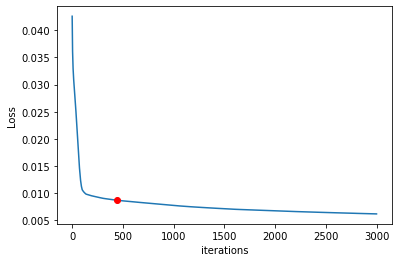

In [177]:
loss_L=np.array(loss_L)
print(loss_L.shape)
plt.plot(loss_L[:,1,0])
plt.plot([438],loss_L[438,1,0],'or')
plt.ylabel('Loss')
plt.xlabel('iterations')

In [95]:
df1=pd.read_csv('seccessfuk_models/metrics.csv')
df2=pd.read_csv('seccessfuk_models/metrics_2.csv')
df1

,Unnamed: 0,with_Conv2,without_average,BA/WGAN_not_agr_mean_kern2
0,0,0.009665,NaN,NaN
1,4,0.009689,NaN,NaN
2,9,0.009714,NaN,NaN
3,14,0.009724,NaN,NaN
4,19,0.009710,NaN,NaN
5,29,0.009950,NaN,NaN


In [101]:
df2.set_index('Unnamed: 0')

,with_CONV2_real,with_noise_198
Unnamed: 0,,
0,0.009894,0.009614
4,0.009829,0.009884
9,0.010362,0.009777
14,0.010088,0.010100
19,0.010132,0.010504
29,0.010674,0.010495


In [117]:
df=df1.join(df2.set_index('Unnamed: 0'),on='Unnamed: 0')
df=df.dropna(axis=1, how='all')
df

,Unnamed: 0,with_Conv2,with_CONV2_real,with_noise_198
0,0,0.009665,0.009894,0.009614
1,4,0.009689,0.009829,0.009884
2,9,0.009714,0.010362,0.009777
3,14,0.009724,0.010088,0.010100
4,19,0.009710,0.010132,0.010504
5,29,0.009950,0.010674,0.010495


In [118]:
df3=pd.read_csv('seccessfuk_models/metrics_3.csv')

df4=pd.read_csv('seccessfuk_models/metrics_4.csv')
df3

,Unnamed: 0,without_average
0,0,0.009702
1,4,0.010173
2,9,0.010420
3,14,0.010400
4,19,0.010376
5,29,0.009801


In [149]:
df=df1.join(df2.set_index('Unnamed: 0'),on='Unnamed: 0')
df=df.dropna(axis=1, how='all')
df=df.join(df3.set_index('Unnamed: 0'),on='Unnamed: 0',how='left')
df=df.join(df4.set_index('Unnamed: 0'),on='Unnamed: 0',how='left')
df=df.rename(columns={'Unnamed: 0': 'epochs', "with_Conv2": "model 1","with_CONV2_real": "model 2","with_noise_198": "model 3",
                    "without_average": "model 4","BA/WGAN_not_agr_mean_kern2": "model 5" })
df['epochs']=df['epochs'].add(1)
df=df.set_index('epochs')
df

,model 1,model 2,model 3,model 4,model 5
epochs,,,,,
1,0.009665,0.009894,0.009614,0.009702,0.010054
5,0.009689,0.009829,0.009884,0.010173,0.010288
10,0.009714,0.010362,0.009777,0.010420,0.010251
15,0.009724,0.010088,0.010100,0.010400,0.009825
20,0.009710,0.010132,0.010504,0.010376,0.009756
30,0.009950,0.010674,0.010495,0.009801,0.009754


In [150]:
import pandas.io.formats.style
def highlight_min(s):
    is_min = s == s.min()
      
    return ['background: lightgreen' if cell else '' 
            for cell in is_min]
df.style
df.style.clear()
df.style.highlight_min(axis=0)

,model 1,model 2,model 3,model 4,model 5
epochs,,,,,
1,0.009665,0.009894,0.009614,0.009702,0.010054
5,0.009689,0.009829,0.009884,0.010173,0.010288
10,0.009714,0.010362,0.009777,0.010420,0.010251
15,0.009724,0.010088,0.010100,0.010400,0.009825
20,0.009710,0.010132,0.010504,0.010376,0.009756
30,0.009950,0.010674,0.010495,0.009801,0.009754


In [141]:
dir_name=os.path.join('seccessfuk_models',"with_noise_198")
gen_n=f'{dir_name}/save_model/generator/ep{ep}'
generator=tf.keras.models.load_model(gen_n)
disc_n=f'{dir_name}/save_model/discriminator/ep{ep}'
discriminator=tf.keras.models.load_model(disc_n)
generator.summary()

Model: "Generator_model_"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 398)]        0                                            
__________________________________________________________________________________________________
tf.__operators__.getitem (Slici (None, 200)          0           input_1[0][0]                    
__________________________________________________________________________________________________
dense (Dense)                   (None, 200)          40000       tf.__operators__.getitem[0][0]   
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 200)          800         dense[0][0]                      
___________________________________________________________________________________

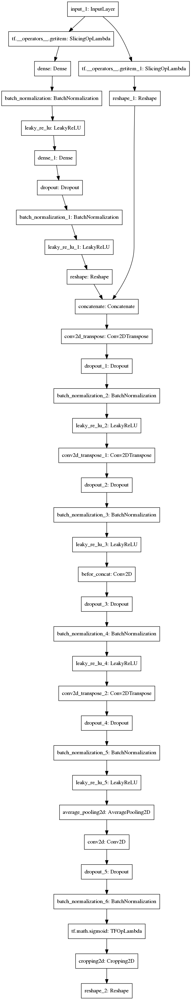

In [142]:
tf.keras.utils.plot_model(generator)

# больше дэтекторов

In [2]:
import h5py
with h5py.File("../mk_all_old.h5",'r') as f:
#     print(list(f.keys()))
    
    print(f['sddata'].keys())
    print(f['sddata']['dt'])# вырезки центрированные около середины ливня size 6x6
    data=f['sddata']['dt'][:]
    print(f['sddata']['ev_params'][:,1])
    data=f['sddata']['dt'][:]
    print(f['norm_param_global_18.0_qgs3_all']['wf_fl']['mean'][:])

<KeysViewHDF5 ['dt', 'dt_fl', 'ev_params', 'gp', 'mask_fl', 'wf_fl', 'wf_max']>
<HDF5 dataset "dt": shape (21951, 6, 6, 8), type "<f4">
[  0.    190.784 261.837 ... 247.871 144.291 195.698]
[0.12382405 0.12471041]


In [4]:
data[0,:5,:5,0]

array([[ 0.      ,  0.      ,  0.      ,  0.      ,  0.      ],
       [ 0.      ,  0.      ,  0.      ,  0.      ,  0.      ],
       [ 0.      ,  0.      ,  0.      , -0.814793, -0.814862],
       [ 0.      ,  0.      ,  0.18328 ,  0.198171,  0.182116],
       [ 0.      ,  0.      ,  0.      ,  1.1809  ,  0.      ]],
      dtype=float32)

In [5]:
data[0,:6,:6,6]

array([[0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 1., 1., 0.],
       [0., 0., 1., 1., 1., 1.],
       [0., 0., 0., 1., 0., 0.],
       [0., 0., 0., 0., 0., 0.]], dtype=float32)

[0.09531018 0.09531018 0.09531018 0.09531018 0.09531018 0.09531018
 0.09531018 0.09531018 0.09531018 0.09531018 0.09531018 0.09531018
 0.09531018 0.09531018 0.09531018 0.09531018 0.09531018 0.09531018
 0.09531018 0.09531018 0.09531018 0.09531018 0.09531018 0.09531018
 0.09531018 0.09531018 0.09531018 0.09531018 0.09531018 0.09531018
 0.09531018 0.09531018 0.09531018 0.09531018 0.09531018 0.09531018
 0.09531018 0.09531018 0.09531018 0.09531018 0.09531018 0.09531018
 0.09531018 0.09531018 0.09531018 0.09531018 0.09531018 0.09531018
 0.09531018 0.09531018 0.09531018 0.09531018 0.09531018 0.09531018
 0.09531018 0.09531018 0.09531018 0.09531018 0.09531018 0.09531018
 0.09531018 0.09531018 0.09531018 0.09531018 0.09531018 0.09531018
 0.09531018 0.09531018 0.09531018 0.09531018 0.09531018 0.09531018
 0.09531018 0.09531018 0.09531018 0.09531018 0.09531018 0.09531018
 0.09531018 0.09531018 0.09531018 0.09531018 0.09531018 0.09531018
 0.09531018 0.09531018 0.09531018 0.09531018 0.09531018 0.0953

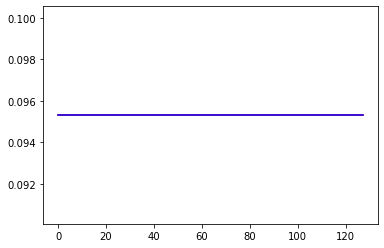

In [90]:
def Descriminatr():
    input_tensor=tf.keras.In

Model: "General_discriminator"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_55 (InputLayer)           [(None, 10, 128, 2)] 0                                            
__________________________________________________________________________________________________
tf.__operators__.getitem_43 (Sl (10, 128, 2)         0           input_55[0][0]                   
__________________________________________________________________________________________________
tf.__operators__.getitem_44 (Sl (10, 128, 2)         0           input_55[0][0]                   
__________________________________________________________________________________________________
Discriminator_model_num_0 (Func (None, 1)            157033      tf.__operators__.getitem_43[0][0]
______________________________________________________________________________

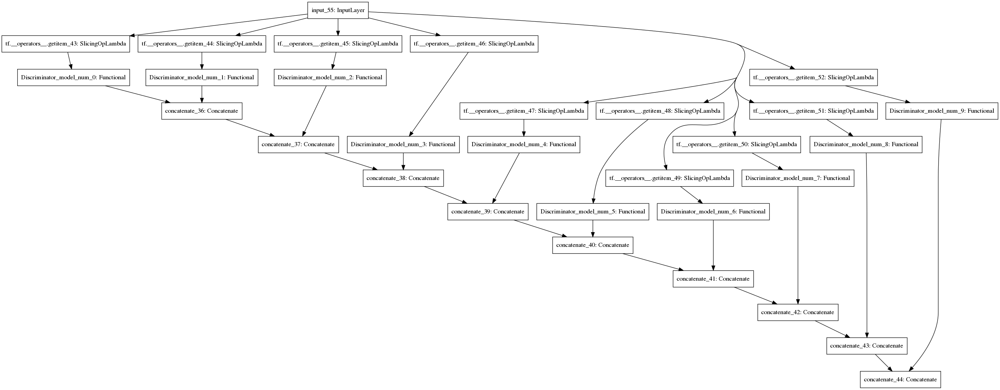

In [19]:
def General_discriminator(num:int):
    input_tensor=tf.keras.Input(shape=(num,128,2))
    for i in range(num):
        discriminator=Discriminator_model(str(i))
        one_det=discriminator(input_tensor[i])
        if i == 0:
            all_res=one_det
        else:
            all_res=tf.keras.layers.concatenate([all_res,one_det])
    
    model= tf.keras.Model(input_tensor,all_res,name="General_discriminator")
#     assert model.output_shape == (None, 128, 2, 1)
    return model
d=General_discriminator(10)
d.summary()
tf.keras.utils.plot_model(d)

In [ ]:
def General_generator(num:int):
    input_tensor=tf.keras.Input(shape=(noise_dim,))
    for i in range(num):
        discriminator=Discriminator_model(str(i))
        one_det=discriminator(input_tensor[i])
        if i == 0:
            all_res=one_det
        else:
            all_res=tf.keras.layers.concatenate([all_res,one_det])
    
    model= tf.keras.Model(input_tensor,all_res,name="General_discriminator")
#     assert model.output_shape == (None, 128, 2, 1)
    return model
d=General_discriminator(10)
d.summary()
tf.keras.utils.plot_model(d)